# Combination of annotation methods

#### Working directory should contain root atlas Seurat object, which is available on GEO under record GSE152766:

    Root_Atlas.rds (or get it by running through notebook 2, 3, 4, 5 & 6)

#### Working directory must contain subdirectories,supp_data

#### supp_data/ should contain the files, which are available on Github (github.com/Hsu-Che-Wei/COPILOT):

    Protoplasting_DEgene_FC2_list.txt
    cell_cycle_genes.csv
    color_scheme_at.RData
    Validated_Markers.csv
    spatial_anno.txt (get it by running through notebook 3)
    semitones.curated.marker.anno.nsds5.csv (get it by running through notebook 4)
    semitones.curated.marker.csv (get it by running through notebook 4)
    ici_raw_20200414.csv.bz2 (get it by running through notebook 5)

In [1]:
rm(list=ls())
# Set the working directory to where folders named after the samples are located. 
# The folder contains spliced.mtx, unspliced.mtx, barcodes and gene id files, and json files produced by scKB that documents the sequencing stats. 
setwd("/scratch/AG_Ohler/CheWei/scKB")

In [2]:
# Load libraries
suppressMessages(library(Seurat))
suppressMessages(library(scales))
suppressMessages(library(data.table))
suppressMessages(library(tidyverse))
suppressMessages(library(ggplot2))
suppressMessages(library(grid))


In [3]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: CentOS Linux 7 (Core)

Matrix products: default
BLAS/LAPACK: /fast/home/c/chsu/anaconda3/envs/seu3/lib/libopenblasp-r0.3.12.so

locale:
 [1] LC_CTYPE=en_US.utf-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.utf-8        LC_COLLATE=en_US.utf-8    
 [5] LC_MONETARY=en_US.utf-8    LC_MESSAGES=en_US.utf-8   
 [7] LC_PAPER=en_US.utf-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.utf-8 LC_IDENTIFICATION=C       

attached base packages:
[1] grid      stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] forcats_0.5.0     stringr_1.4.0     dplyr_1.0.2       purrr_0.3.4      
 [5] readr_1.4.0       tidyr_1.1.2       tibble_3.0.4      ggplot2_3.3.2    
 [9] tidyverse_1.3.0   data.table_1.13.2 scales_1.1.1      Seurat_3.1.5     

loaded via a namespace (and not attached):
 [1] nlme_

## 1. Load data

In [4]:
# Load unwanted genes, which are genes being induced during protoplasting in our case
pp.genes <- as.character(read.table("./supp_data/Protoplasting_DEgene_FC2_list.txt", header=F)$V1)
cc.genes <- as.character(read.table("./supp_data/cell_cycle_genes.csv", header=TRUE, sep=",")$Locus)

# Load the color scheme for time and cell type annotation
load("./supp_data/color_scheme_at.RData")

# Load known markers, including both wet-lab validated and in-silico-derived 
known.good.markers <- read.csv("./supp_data/Validated_Markers.csv", header=T)  

# Load novoSpaRc output
spa <- read.table("./supp_data/spatial_anno.txt", sep="\t", header=TRUE)

# Load SEMITONES output
escore <- read.csv("./supp_data/semitones.curated.marker.anno.nsds5.csv", header=T)
escore <- escore +1
es <- fread("./supp_data/semitones.curated.marker.csv", header = T)

# Load ICI output
ici_raw <- fread("./supp_data/ici_raw_20200414.csv.bz2")

In [5]:
# Read in the atlas
rc.integrated <- readRDS('./supp_data/Root_Atlas.rds')

## 2. Z-Score annotation

In [10]:
zscore <- function(x){(x-mean(x))/sd(x)}

In [11]:
known.good.markers$Celltype <- gsub("Columella (1-4th Outer Layer) + LRC (3 Vertical Layers from Columella)", "Columella", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Columella (1st Outer Layer) + LRC (1st +2nd Outer Layer)", "Root Cap", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Columella (1st Outer Layer) + LRC (1st Outer Layer)", "Root Cap", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Columella (1-3th Outer Layer)", "Columella", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Columella (1-5th Outer Layer)", "Columella", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Columella + LRC", "Root Cap", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Cortex + Endodermis", "Ground Tissue", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Procambium + Phloem", "Procambium", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Procambium + Xylem", "Procambium", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Quiescent Center + Columella", "Columella", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("LRC + Atrichoblast", "Atrichoblast", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Phloem", "Metaphloem & Companion Cell", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Metaphloem & Companion Cell;Metaphloem & Companion Cell Pole Pericycle", "Phloem Pole Pericycle", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("PSE", "Phloem Sieve Element", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Proximal Columella", "Columella", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Distal Columella", "Columella", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Celltype <- gsub("Pericycle Initials", "Xylem Pole Pericycle", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);

In [12]:
msc <- c()
for (i in as.character(unique(known.good.markers$Celltype))){
    if (length(known.good.markers[which(known.good.markers$Celltype== i),]$Locus)>1){
    msc <- cbind(msc, as.numeric(apply(apply(rc.integrated@assays$SCT@data[known.good.markers[which(known.good.markers$Celltype== i),]$Locus,], 1, zscore), 1, mean)))       
    } else {
    msc <- cbind(msc, as.numeric(zscore(rc.integrated@assays$SCT@data[known.good.markers[which(known.good.markers$Celltype== i),]$Locus,])))      
    }

}
colnames(msc) <- as.character(unique(known.good.markers$Celltype))
rownames(msc) <- colnames(rc.integrated)

In [14]:
# Find clusters, here we choose Leiden clustering algorithm with resolution 0.5. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
suppressMessages(suppressWarnings(
  rc.integrated <- FindClusters(rc.integrated, resolution = 500, algorithm = 3)
))

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 110427
Number of edges: 3393008

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.4077
Number of communities: 3034
Elapsed time: 103 seconds


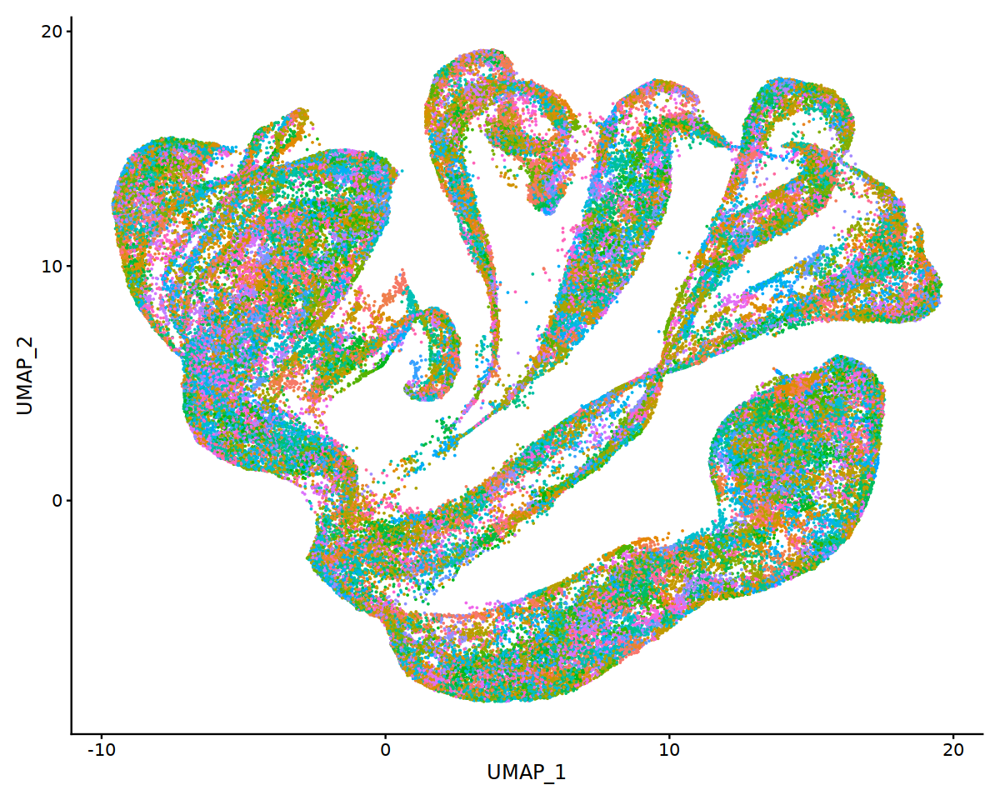

In [15]:
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap")+NoLegend()

In [16]:
anno <- rc.integrated$seurat_clusters
for (i in unique(rc.integrated$seurat_clusters)){
    if (max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean))>0){
        ct <- names(which.max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean)))
    } else {
        ct <- "NA"
    }
        anno <- gsub(paste0("^",i,"$"), ct, anno, ignore.case = FALSE, perl = FALSE,fixed = FALSE, useBytes = FALSE)
}

In [17]:
rc.integrated$score.anno <- anno

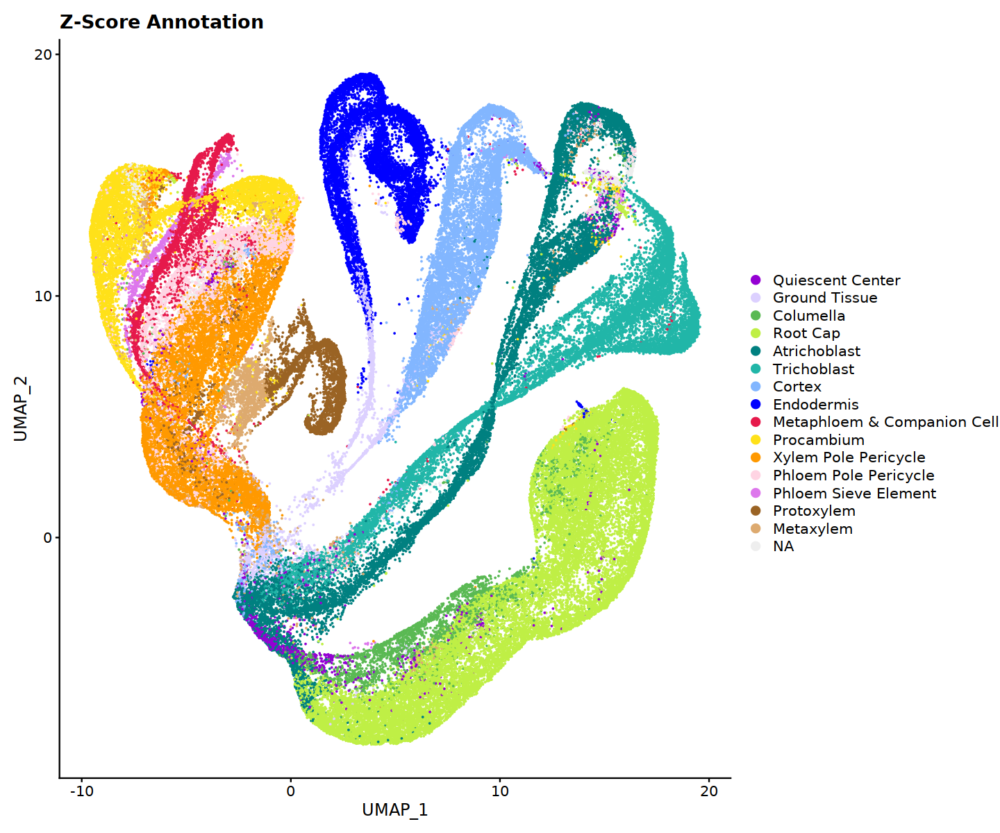

In [18]:
# Plot marker annotation
order <- c("Quiescent Center", "Ground Tissue","Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Metaphloem & Companion Cell", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle","Phloem Sieve Element", "Protoxylem", "Metaxylem", "NA")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$score.anno <- factor(rc.integrated$score.anno , levels = order[sort(match(unique(rc.integrated$score.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$score.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "score.anno", cols = color)+ggtitle("Z-Score Annotation")

## 3. SEMITONES (marker-based annotation)

In [14]:
# A cell is annotated as the label which its marker has the highest escore 
call.index <- apply(es, 2, function(x){colnames(escore)[which(x==max(x))]});
pos.index <- apply(es, 2, function(x){if(max(x)<0){"negative"}else{"positive"}})

escore.anno <- c()
for (i in colnames(escore)){
  ea <- rep('NA',ncol(rc.integrated))  
  ea[escore[,i][!is.na(escore[,i])]] = as.character(known.good.markers$Celltype[match(i,known.good.markers$Locus)])
  escore.anno <- cbind(escore.anno,ea)
} 
spec.index <- apply(escore.anno,1,function(x){length(table(x[x!="NA"]))})

escore.anno <- rep('NA',ncol(rc.integrated)) 
for (i in 1:length(call.index)){ 
  if(pos.index[i] == "positive"){
    escore.anno[i] = as.character(known.good.markers$Celltype[match(call.index[i],known.good.markers$Locus)])
  }
} 

escore.anno[which(spec.index == 0)] <- 'NA'

# Store marker annotation results in atlas
rc.integrated$escore.anno <- escore.anno

In [15]:
es <- as.matrix(es)
rownames(es) <- colnames(escore)
colnames(es) <- colnames(rc.integrated)

In [16]:
rc.integrated$escore.crude.anno <- escore.anno

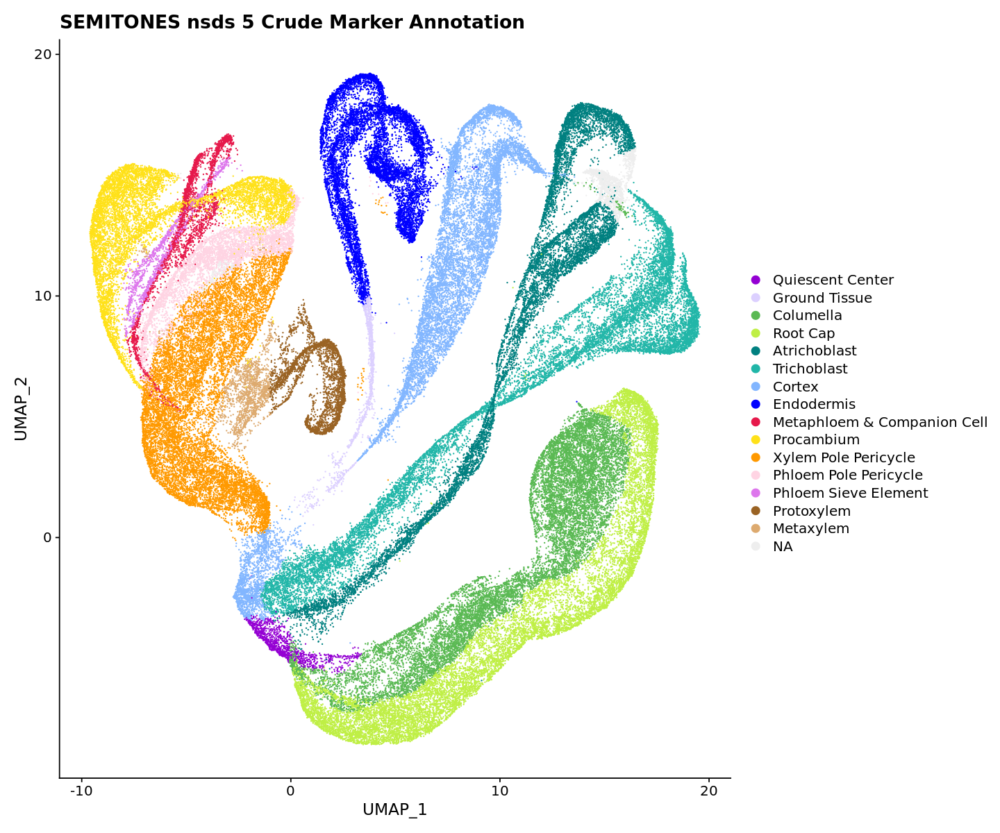

In [17]:
# Plot marker annotation
order <- c("Quiescent Center", "Ground Tissue","Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Metaphloem & Companion Cell", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle","Phloem Sieve Element", "Protoxylem", "Metaxylem", "NA")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$escore.crude.anno <- factor(rc.integrated$escore.crude.anno , levels = order[sort(match(unique(rc.integrated$escore.crude.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$escore.crude.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "escore.crude.anno", cols = color)+ggtitle("SEMITONES nsds 5 Crude Marker Annotation")

## 4. Spatial mapping (novoSpaRc) annotation

In [45]:
rc.integrated@meta.data <- cbind(rc.integrated@meta.data, spa)

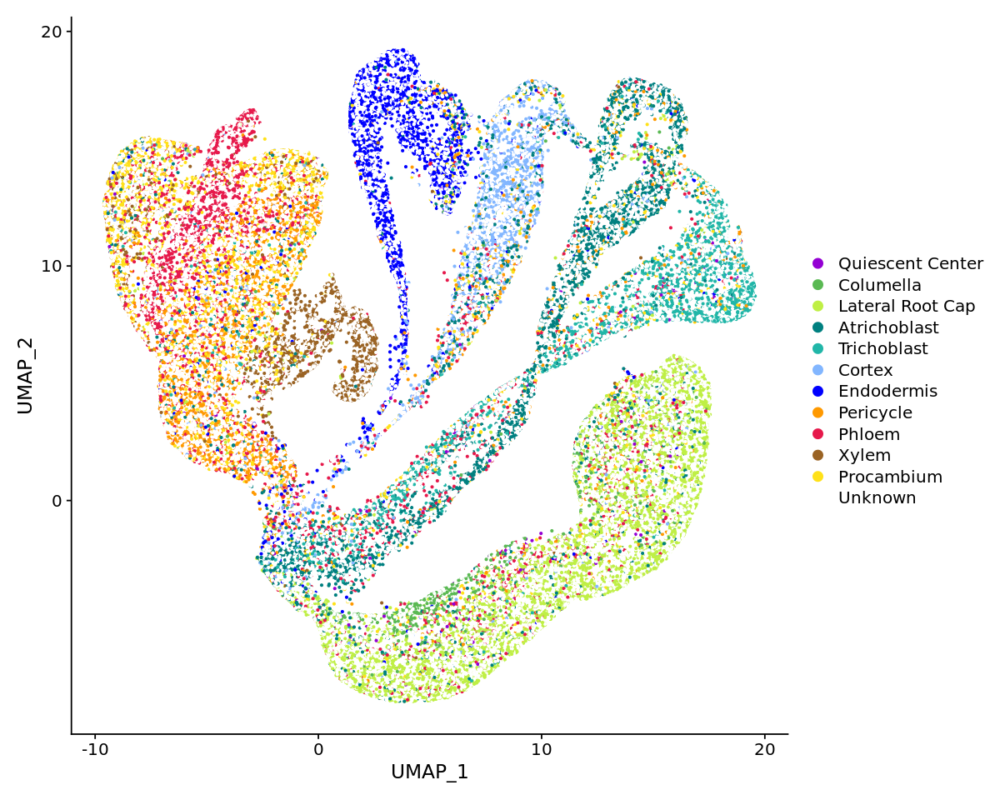

In [20]:
order <- c("Quiescent Center", "Stem Cell Niche", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400d3", "#DCD0FF", "#5AB953", "#BFEF45", "#008080", "#21B6A8", "#82B6FF", "#0000FF","#FF9900","#E6194B", "#9A6324", "#FFE119","#FFFFFF")
rc.integrated$novo.anno <- factor(rc.integrated$novo.anno, levels = order[sort(match(unique(rc.integrated$novo.anno),order))])
color <- palette[sort(match(unique(rc.integrated$novo.anno),order))]
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "novo.anno", cols=color, pt.size=0.5)

## 5. Process ICI output

In [30]:
# Select best ICI annotation based on adjusted-pvale and normalized ICI score 
ici_filtered <- ici_raw %>% group_by(Cell) %>% filter(p_adj == min(p_adj)) %>% filter(ici_score_norm == max(ici_score_norm)) %>% filter(p_val == max(p_val)) %>% filter(ici_score == max(ici_score)) 

# Select samples
ici_atlas <- ici_filtered %>% filter(Dataset == 'sc_12'|Dataset == 'sc_11'|Dataset == 'sc_30'|Dataset == 'sc_31'|Dataset == 'sc_37'|Dataset == 'sc_40'|Dataset == 'sc_51'|Dataset == 'sc_9_at'|Dataset == 'sc_10_at'|Dataset == 'sc_1'|Dataset == 'tnw1'|Dataset == 'tnw2'|Dataset == 'col0'|Dataset == 'pp1'|Dataset == 'dc1'|Dataset == 'dc2')

# Store ICI annotation results in atlas
ord <- unique(rc.integrated$orig.ident)
idx <- c()
for (i in 1:length(ord)){
    idx <- c(idx,gsub(paste0("_",i,"$"),"",gsub("^",paste0(ord[i],"_"),colnames(rc.integrated)[grep(paste0("_",i,"$"),colnames(rc.integrated))])))
}
rownames(ici_atlas) <- ici_atlas$Cell
rc.integrated$ici_celltype <- ici_atlas[idx,]$Cell_Type;
rc.integrated$ici_celltype_score <- ici_atlas[idx,]$ici_score;
rc.integrated$ici_celltype_p_val <- ici_atlas[idx,]$p_val;
rc.integrated$ici_celltype_score_norm <- ici_atlas[idx,]$ici_score_norm;
rc.integrated$ici_celltype_p_adj <- ici_atlas[idx,]$p_adj;
ici.order <- unique(rc.integrated$ici_celltype)

# Merge labels
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Columella_Stem")]="Columella";
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Ground_Cell_Stem")]="Unknown";
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Epidermis_LRC_Stem")]="Lateral_Root_Cap";
rc.integrated$ici_celltype[which(rc.integrated$ici_celltype == "Xylem_Stem")]="Meristematic_Xylem";
rc.integrated$ici_celltype[is.na(rc.integrated$ici_celltype)] = "Unknown"

Warning message:
“Setting row names on a tibble is deprecated.”


## 6. ICI annotation

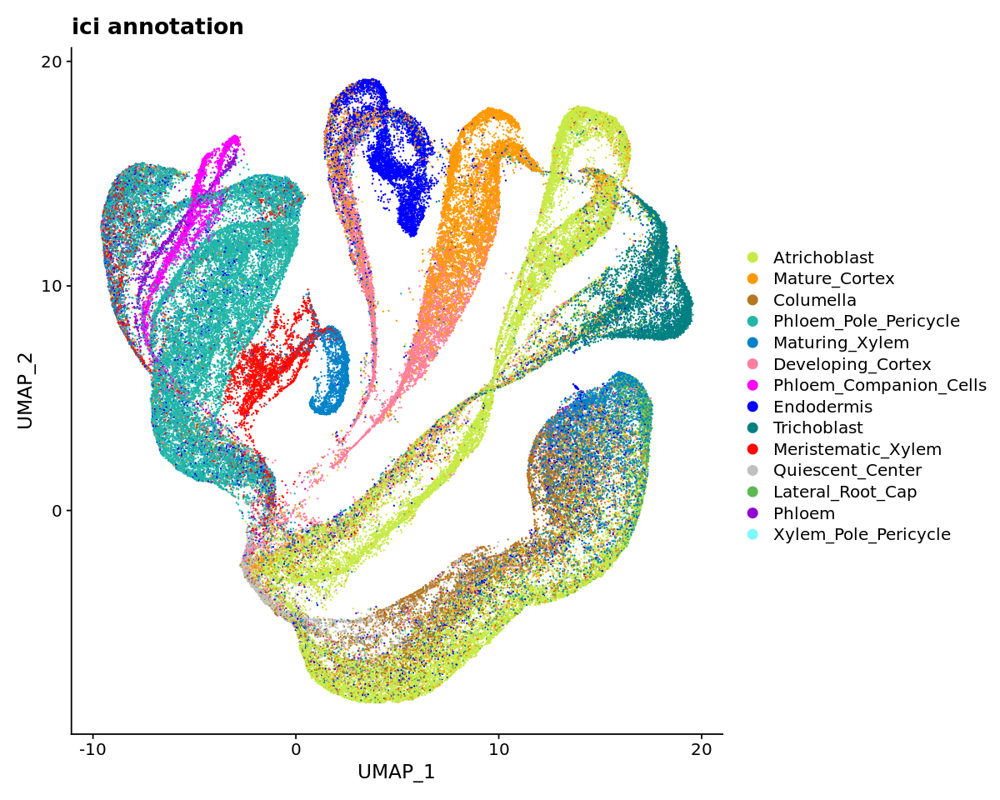

In [31]:
# Plot ICI annotation
ici.order <- unique(rc.integrated$ici_celltype)
ici.palette <- c('#C7EA46','#FF9900','#B67721','#21B6A8','#0082C8','#FE7F9C','#FF00FF','#0000FF','#008081','#FF0800','#C0C0C0','#5AB953','#9400D3','#7EF9FF')
rc.integrated$ici_celltype <- factor(rc.integrated$ici_celltype, levels = ici.order[sort(match(unique(rc.integrated$ici_celltype),ici.order))]) 
color.ici <- ici.palette[sort(match(unique(rc.integrated$ici_celltype),ici.order))]
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "ici_celltype", cols = color.ici)+ggtitle("ici annotation")

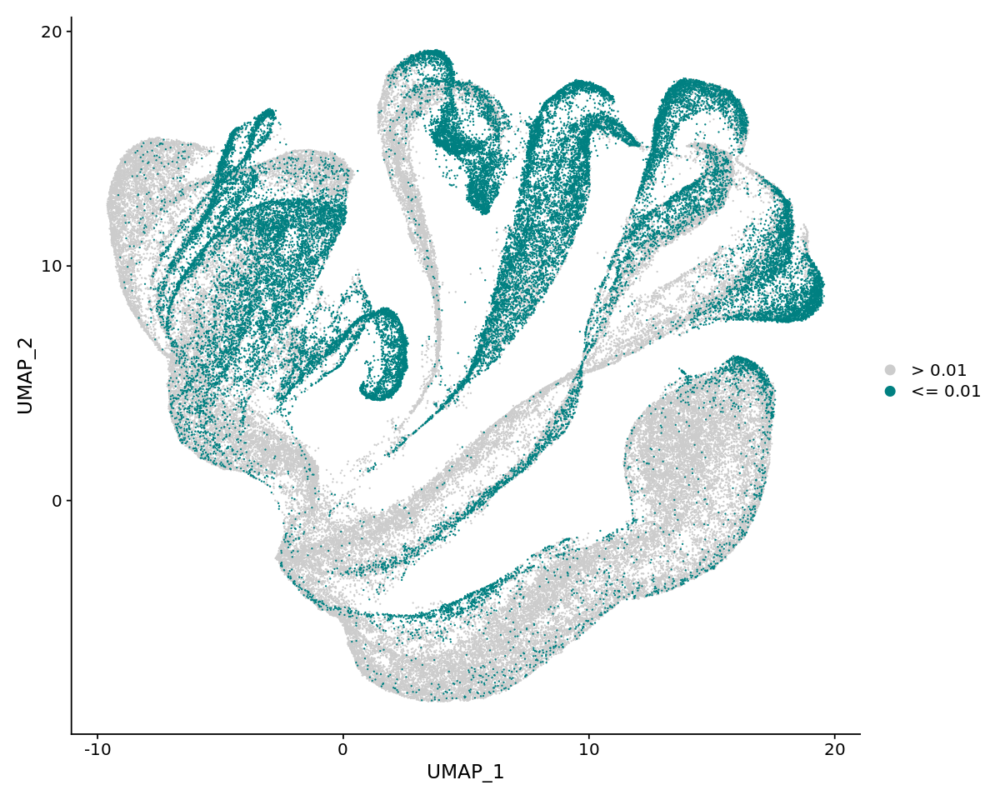

In [32]:
rc.integrated$ici_significance <- rep("> 0.01", nrow(rc.integrated@meta.data))
rc.integrated$ici_significance[which(rc.integrated$ici_celltype_p_adj <= 0.01)] = "<= 0.01"
DimPlot(rc.integrated, reduction = "umap", group.by = "ici_significance", order = c("<= 0.01","> 0.01"),cols = c("#cccccc", "#008081"))

## 7. Correlation-based annotation

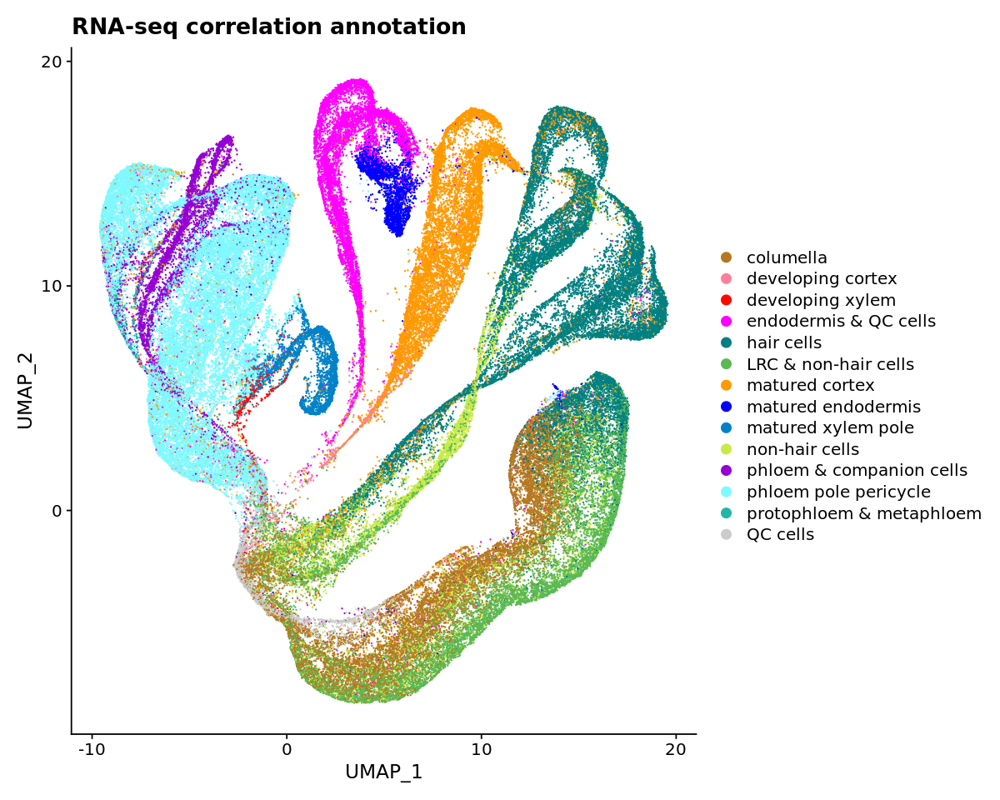

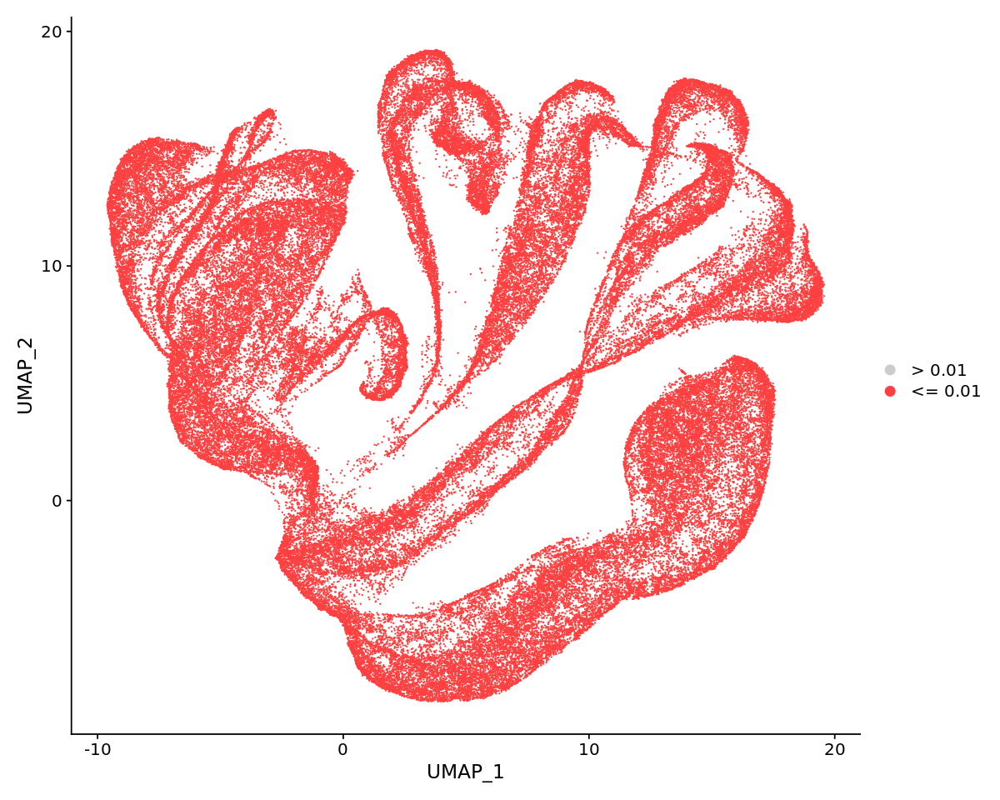

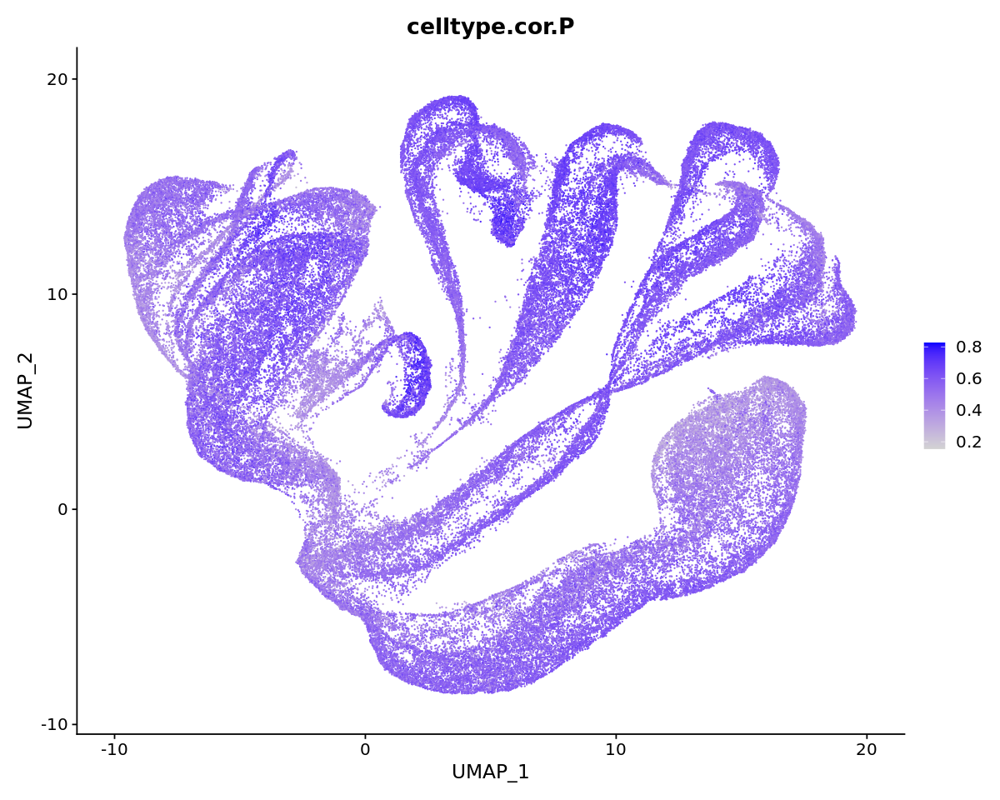

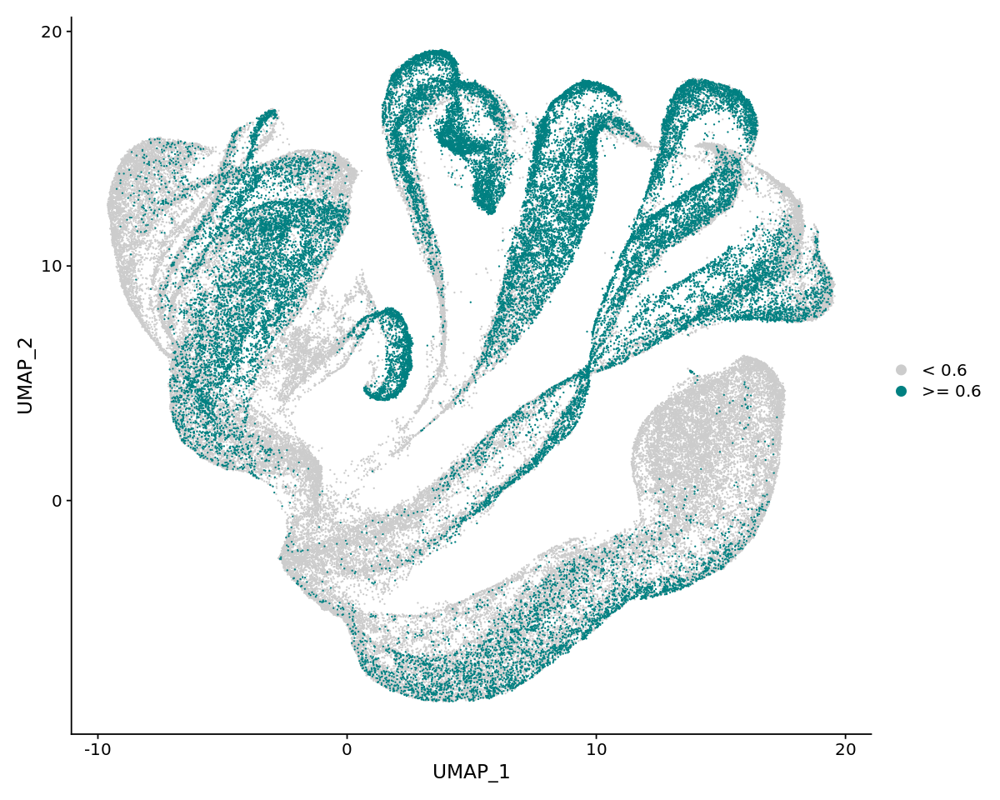

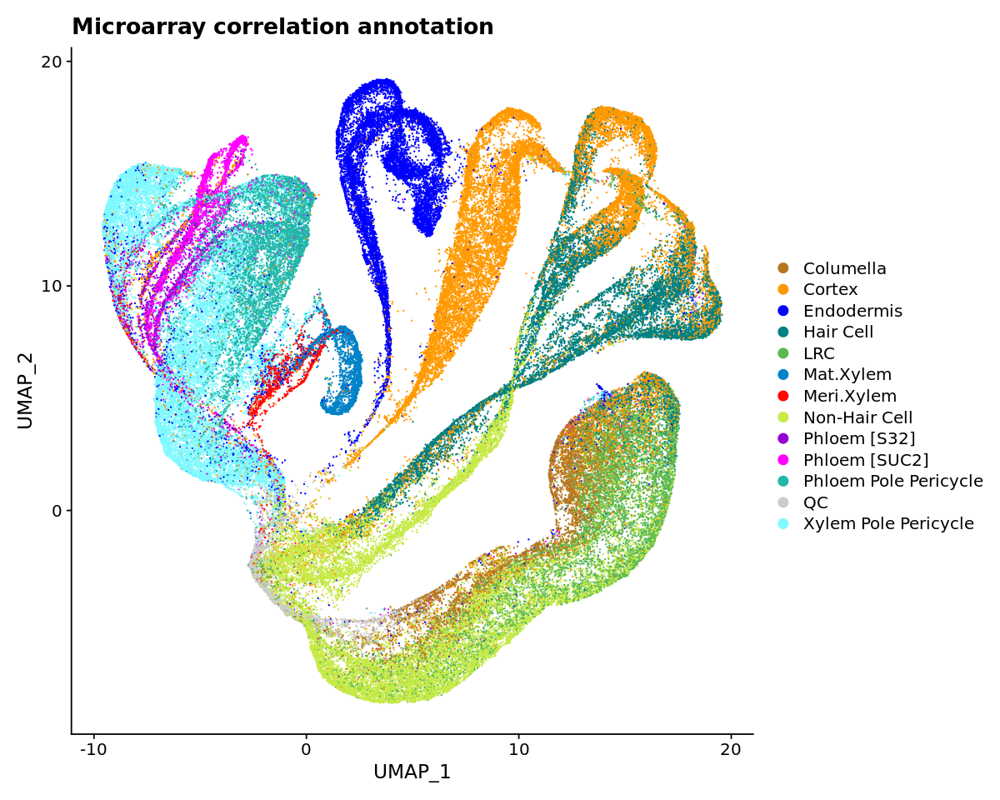

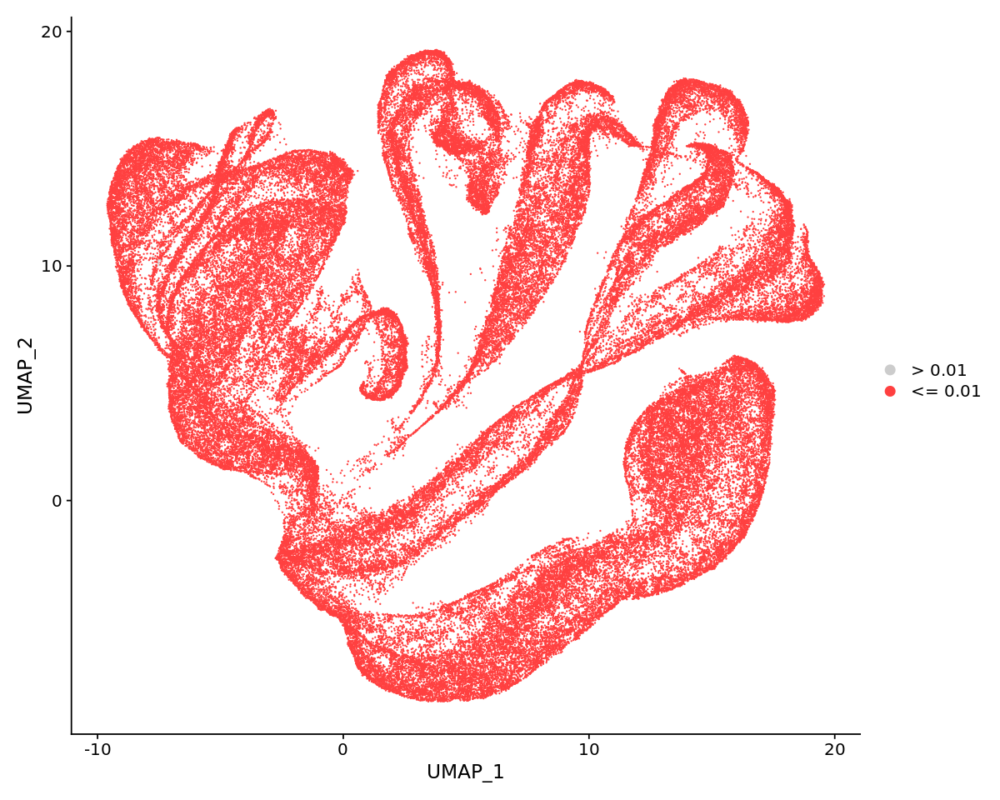

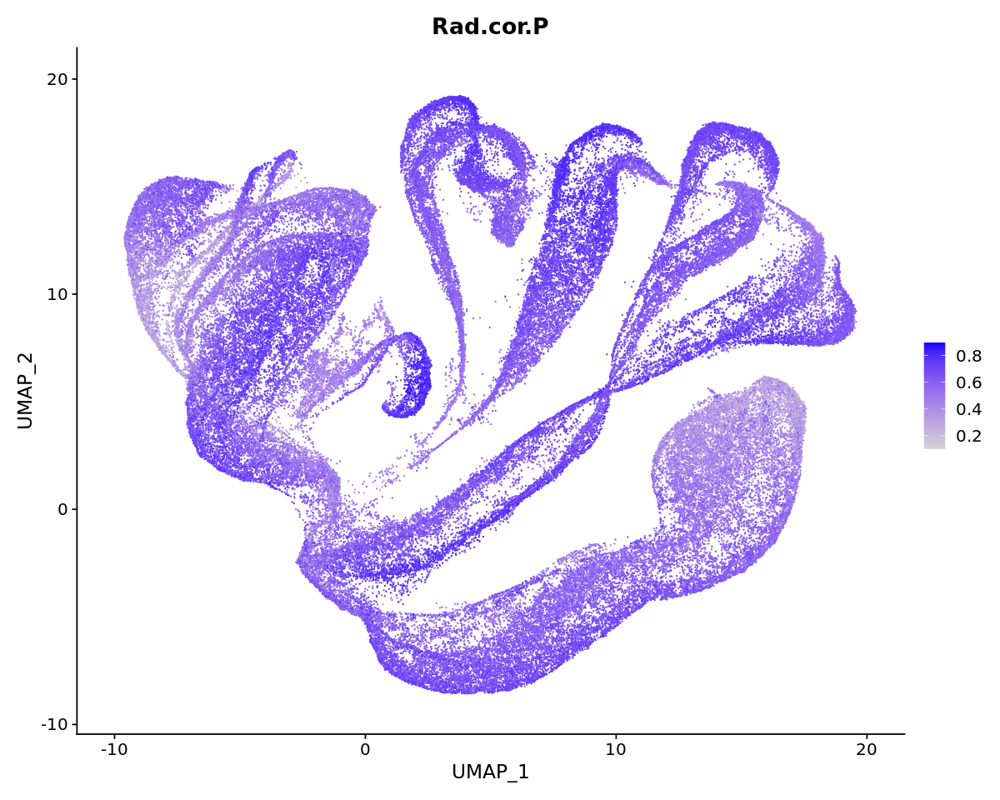

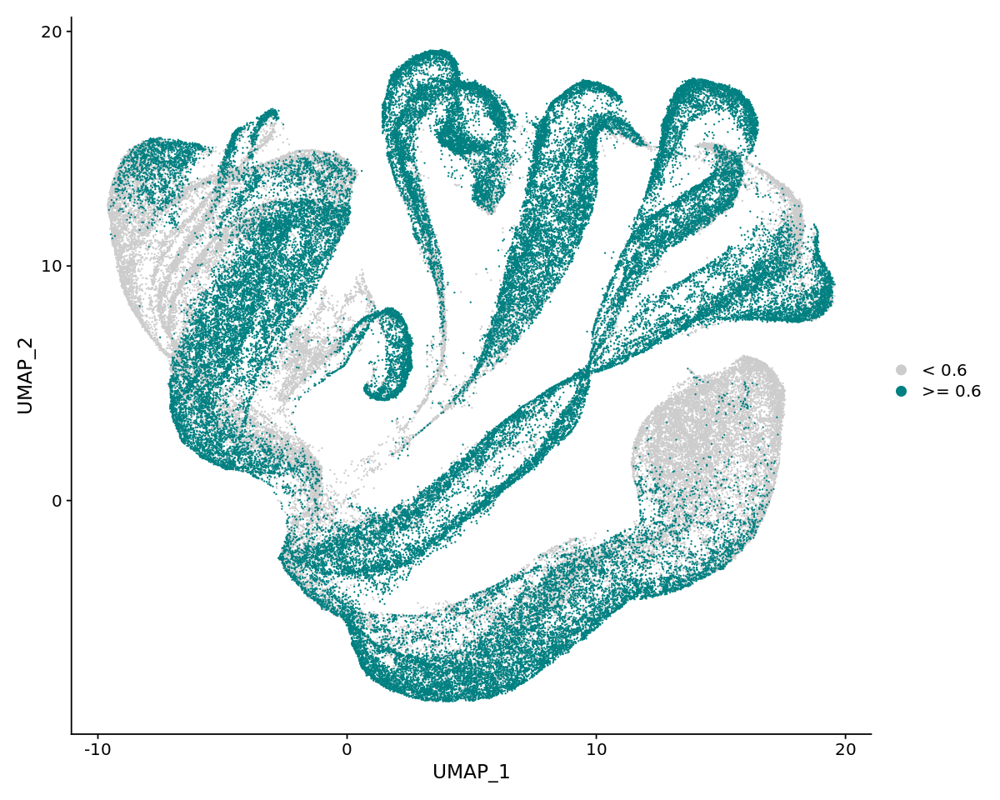

In [33]:
# Plot correlation-based annotation
color <- celltypepalette[sort(match(unique(rc.integrated$celltype.ID.P),celltypeorder))]
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.ID.P", cols = color)+ggtitle("RNA-seq correlation annotation")
rc.integrated$celltype.ID.P_significance <- rep("> 0.01", nrow(rc.integrated@meta.data))
rc.integrated$celltype.ID.P_significance[which(rc.integrated$celltype.pvalue.P <= 0.01)] = "<= 0.01"
rc.integrated$celltype.cor.P_significance <- rep(">= 0.6", nrow(rc.integrated@meta.data))
rc.integrated$celltype.cor.P_significance[which(rc.integrated$celltype.cor.P < 0.6)] = "< 0.6"
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.ID.P_significance", order = c("<= 0.01","> 0.01"),cols = c("#cccccc", "#ff4040"))
FeaturePlot(rc.integrated, reduction = "umap", features = "celltype.cor.P")
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.cor.P_significance", order = c(">= 0.6","< 0.6"),cols = c("#cccccc", "#008081"))
rc.integrated$Rad.ID.P <- factor(rc.integrated$Rad.ID.P, levels = radorder[sort(match(unique(rc.integrated$Rad.ID.P),radorder))])
color <- radpalette[sort(match(unique(rc.integrated$Rad.ID.P),radorder))]
DimPlot(rc.integrated, reduction = "umap", group.by = "Rad.ID.P", cols = color)+ggtitle("Microarray correlation annotation")
rc.integrated$Rad.ID.P_significance <- rep("> 0.01", nrow(rc.integrated@meta.data))
rc.integrated$Rad.ID.P_significance[which(rc.integrated$Rad.pvalue.P <= 0.01)] = "<= 0.01"
rc.integrated$Rad.cor.P_significance <- rep(">= 0.6", nrow(rc.integrated@meta.data))
rc.integrated$Rad.cor.P_significance[which(rc.integrated$Rad.cor.P < 0.6)] = "< 0.6"
DimPlot(rc.integrated, reduction = "umap", group.by = "Rad.ID.P_significance", order = c("<= 0.01","> 0.01"),cols = c("#cccccc", "#ff4040"))
FeaturePlot(rc.integrated, reduction = "umap", features = "Rad.cor.P")
DimPlot(rc.integrated, reduction = "umap", group.by = "Rad.cor.P_significance", order = c(">= 0.6","< 0.6"),cols = c("#cccccc", "#008081"))

## 8. Make consensus annotation

In [34]:
# Correlation-based annotation
hc.rna.anno <- as.character(rc.integrated$celltype.ID.P);
hc.ma.anno <- as.character(rc.integrated$Rad.ID.P);
# ICI annotation
hc.ici.anno <- as.character(rc.integrated$ici_celltype);
# Marker-based annotation
hc.km.anno <- as.character(rc.integrated$escore.crude.anno)
hc.ms.anno <- as.character(rc.integrated$score.anno)
# Spatial annotation
hc.sp.anno <- as.character(rc.integrated$novo.anno)
hc.sp.anno[which(rc.integrated$novo.anno == "Unknown")] = "NA";
# Root Cap Spatial annotation
hc.rcsp.anno <- as.character(rc.integrated$annotation_ncfqc)
hc.rcsp.anno[which(rc.integrated$annotation_ncfqc == "Unknown")] = "NA";

In [35]:
# Merge and unify labels of annotation
hc.km.anno[which(hc.km.anno == "Protoxylem")]="Xylem"
hc.km.anno[which(hc.km.anno == "Metaxylem")]="Xylem"
hc.ms.anno[which(hc.ms.anno == "Protoxylem")]="Xylem"
hc.ms.anno[which(hc.ms.anno == "Metaxylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Hair Cell")]="Trichoblast"
hc.ma.anno[which(hc.ma.anno == "LRC")]="Lateral Root Cap"
hc.ma.anno[which(hc.ma.anno == "Mat.Xylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Meri.Xylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Non-Hair Cell")]="Atrichoblast"
hc.ma.anno[which(hc.ma.anno == "Phloem [S32]")]="Phloem Sieve Element"
hc.ma.anno[which(hc.ma.anno == "Phloem [SUC2]")]="Metaphloem & Companion Cell"
hc.ma.anno[which(hc.ma.anno == "QC")]="Quiescent Center"
hc.rna.anno[which(hc.rna.anno == "columella")]="Columella"
hc.rna.anno[which(hc.rna.anno == "developing cortex")]="Cortex"
hc.rna.anno[which(hc.rna.anno == "developing xylem")]="Xylem"
hc.rna.anno[which(hc.rna.anno == "endodermis & QC cells")]="Endodermis"
hc.rna.anno[which(hc.rna.anno == "hair cells")]="Trichoblast"
hc.rna.anno[which(hc.rna.anno == "LRC & non-hair cells")]="Lateral Root Cap"
hc.rna.anno[which(hc.rna.anno == "matured cortex")]="Cortex"
hc.rna.anno[which(hc.rna.anno == "matured endodermis")]="Endodermis"
hc.rna.anno[which(hc.rna.anno == "matured xylem pole")]="Xylem"
hc.rna.anno[which(hc.rna.anno == "non-hair cells")]="Atrichoblast"
hc.rna.anno[which(hc.rna.anno == "phloem & companion cells")]="Phloem"
hc.rna.anno[which(hc.rna.anno == "phloem pole pericycle")]="Phloem Pole Pericycle"
hc.rna.anno[which(hc.rna.anno == "protophloem & metaphloem")]="Phloem Sieve Element"
hc.rna.anno[which(hc.rna.anno == "QC cells")]="Quiescent Center"
hc.ici.anno[which(hc.ici.anno == "Mature_Cortex")]="Cortex"
hc.ici.anno[which(hc.ici.anno == "Phloem_Pole_Pericycle")]="Phloem Pole Pericycle"
hc.ici.anno[which(hc.ici.anno == "Maturing_Xylem")]="Xylem"
hc.ici.anno[which(hc.ici.anno == "Developing_Cortex")]="Cortex"
hc.ici.anno[which(hc.ici.anno == "Phloem_Companion_Cells")]="Metaphloem & Companion Cell"
hc.ici.anno[which(hc.ici.anno == "Meristematic_Xylem")]="Xylem"
hc.ici.anno[which(hc.ici.anno == "Quiescent_Center")]="Quiescent Center"
hc.ici.anno[which(hc.ici.anno == "Lateral_Root_Cap")]="Lateral Root Cap"
hc.ici.anno[which(hc.ici.anno == "Xylem_Pole_Pericycle")]="Xylem Pole Pericycle"
hc.ici.anno[which(hc.ici.anno == "Phloem_Companion_Cells")]="Metaphloem & Companion Cell"

In [36]:
# Merge annotations and metadata
cb.anno <- data.frame(hc.rna.anno=hc.rna.anno,hc.ma.anno=hc.ma.anno,hc.ici.anno=hc.ici.anno,hc.km.anno=hc.km.anno,hc.sp.anno=hc.sp.anno, hc.rcsp.anno=hc.rcsp.anno,hc.ms.anno=hc.ms.anno)
num.unique <- apply(cb.anno,1,function(x){length(unique(x[which(x!="NA")]))})
num.not.NA <- apply(cb.anno,1,function(x){length(which(x!="NA"))})
ici.not.NA <- apply(cb.anno,1,function(x){length(which(x[3]!="NA"))})
km.not.NA <- apply(cb.anno,1,function(x){length(which(x[4]!="NA"))})
ms.not.NA <- apply(cb.anno,1,function(x){length(which(x[7]!="NA"))})
cb.anno$num.unique <- num.unique 
cb.anno$num.not.NA <- num.not.NA 
cb.anno$ici.not.NA <- ici.not.NA
cb.anno$km.not.NA <- km.not.NA
cb.anno$ms.not.NA <- ms.not.NA
cb.anno$Cell_ID <- colnames(rc.integrated)
cb.anno$order <- seq(1,ncol(rc.integrated))

In [37]:
# Combined annotation for root cap
cb.anno.ground <- cb.anno %>% filter(hc.ms.anno == "Ground Tissue")
cb.anno.rootcap <- cb.anno %>% filter(hc.km.anno == "Root Cap" | hc.km.anno == "Columella") 

In [38]:
# For making consensus annotation, we only keep those with correlation coefficient > 0.6 and adjusted p-value/p-value < 0.01
# Correlation-based annotation
hc.rna.anno <- as.character(rc.integrated$celltype.ID.P);
hc.rna.anno[which(rc.integrated$celltype.pvalue.P > 0.01)] = "NA";
hc.rna.anno[which(rc.integrated$celltype.cor.P < 0.6)] = "NA";
hc.ma.anno <- as.character(rc.integrated$Rad.ID.P);
hc.ma.anno[which(rc.integrated$Rad.pvalue.P > 0.01)] = "NA";
hc.ma.anno[which(rc.integrated$Rad.cor.P < 0.6)] = "NA";
# ICI annotation
hc.ici.anno <- as.character(rc.integrated$ici_celltype);
hc.ici.anno[which(rc.integrated$ici_celltype_p_adj > 0.01)] = "NA";
# Marker-based annotation
hc.km.anno <- as.character(rc.integrated$escore.crude.anno)
hc.ms.anno <- as.character(rc.integrated$score.anno)
# Spatial annotation
hc.sp.anno <- as.character(rc.integrated$novo.anno)
hc.sp.anno[which(rc.integrated$novo.anno == "Unknown")] = "NA";
# Root Cap Spatial annotation
hc.rcsp.anno <- as.character(rc.integrated$annotation_ncfqc)
hc.rcsp.anno[which(rc.integrated$annotation_ncfqc == "Unknown")] = "NA";

In [39]:
# Merge and unify labels of annotation
hc.km.anno[which(hc.km.anno == "Protoxylem")]="Xylem"
hc.km.anno[which(hc.km.anno == "Metaxylem")]="Xylem"
hc.ms.anno[which(hc.ms.anno == "Protoxylem")]="Xylem"
hc.ms.anno[which(hc.ms.anno == "Metaxylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Hair Cell")]="Trichoblast"
hc.ma.anno[which(hc.ma.anno == "LRC")]="Lateral Root Cap"
hc.ma.anno[which(hc.ma.anno == "Mat.Xylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Meri.Xylem")]="Xylem"
hc.ma.anno[which(hc.ma.anno == "Non-Hair Cell")]="Atrichoblast"
hc.ma.anno[which(hc.ma.anno == "Phloem [S32]")]="Phloem Sieve Element"
hc.ma.anno[which(hc.ma.anno == "Phloem [SUC2]")]="Metaphloem & Companion Cell"
hc.ma.anno[which(hc.ma.anno == "QC")]="Quiescent Center"
hc.rna.anno[which(hc.rna.anno == "columella")]="Columella"
hc.rna.anno[which(hc.rna.anno == "developing cortex")]="Cortex"
hc.rna.anno[which(hc.rna.anno == "developing xylem")]="Xylem"
hc.rna.anno[which(hc.rna.anno == "endodermis & QC cells")]="Endodermis"
hc.rna.anno[which(hc.rna.anno == "hair cells")]="Trichoblast"
hc.rna.anno[which(hc.rna.anno == "LRC & non-hair cells")]="Lateral Root Cap"
hc.rna.anno[which(hc.rna.anno == "matured cortex")]="Cortex"
hc.rna.anno[which(hc.rna.anno == "matured endodermis")]="Endodermis"
hc.rna.anno[which(hc.rna.anno == "matured xylem pole")]="Xylem"
hc.rna.anno[which(hc.rna.anno == "non-hair cells")]="Atrichoblast"
hc.rna.anno[which(hc.rna.anno == "phloem & companion cells")]="Phloem"
hc.rna.anno[which(hc.rna.anno == "phloem pole pericycle")]="Phloem Pole Pericycle"
hc.rna.anno[which(hc.rna.anno == "protophloem & metaphloem")]="Phloem Sieve Element"
hc.rna.anno[which(hc.rna.anno == "QC cells")]="Quiescent Center"
hc.ici.anno[which(hc.ici.anno == "Mature_Cortex")]="Cortex"
hc.ici.anno[which(hc.ici.anno == "Phloem_Pole_Pericycle")]="Phloem Pole Pericycle"
hc.ici.anno[which(hc.ici.anno == "Maturing_Xylem")]="Xylem"
hc.ici.anno[which(hc.ici.anno == "Developing_Cortex")]="Cortex"
hc.ici.anno[which(hc.ici.anno == "Phloem_Companion_Cells")]="Metaphloem & Companion Cell"
hc.ici.anno[which(hc.ici.anno == "Meristematic_Xylem")]="Xylem"
hc.ici.anno[which(hc.ici.anno == "Quiescent_Center")]="Quiescent Center"
hc.ici.anno[which(hc.ici.anno == "Lateral_Root_Cap")]="Lateral Root Cap"
hc.ici.anno[which(hc.ici.anno == "Xylem_Pole_Pericycle")]="Xylem Pole Pericycle"
hc.ici.anno[which(hc.ici.anno == "Phloem_Companion_Cells")]="Metaphloem & Companion Cell"

In [40]:
# Merge annotations and metadata
cb.anno <- data.frame(hc.rna.anno=hc.rna.anno,hc.ma.anno=hc.ma.anno,hc.ici.anno=hc.ici.anno,hc.km.anno=hc.km.anno,hc.sp.anno=hc.sp.anno,hc.rcsp.anno=hc.rcsp.anno,hc.ms.anno=hc.ms.anno)
num.unique <- apply(cb.anno,1,function(x){length(unique(x[which(x!="NA")]))})
num.not.NA <- apply(cb.anno,1,function(x){length(which(x!="NA"))})
ici.not.NA <- apply(cb.anno,1,function(x){length(which(x[3]!="NA"))})
km.not.NA <- apply(cb.anno,1,function(x){length(which(x[4]!="NA"))})
ms.not.NA <- apply(cb.anno,1,function(x){length(which(x[7]!="NA"))})
cb.anno$num.unique <- num.unique 
cb.anno$num.not.NA <- num.not.NA 
cb.anno$ici.not.NA <- ici.not.NA
cb.anno$km.not.NA <- km.not.NA
cb.anno$ms.not.NA <- ms.not.NA
cb.anno$Cell_ID <- colnames(rc.integrated)
cb.anno$order <- seq(1,ncol(rc.integrated))

In [41]:
cb.anno.ground$annotation <- apply(cb.anno.ground,1,function(x){if (x[5]=="NA"){"Unknown"}else if(x[5]=="Endodermis"){"Endodermis"}else if(sort(table(as.character(x[1:5])), decreasing=TRUE)[1] > 1) {names(sort(table(as.character(x[1:5])), decreasing=TRUE))[1]}else{"Unknown"}})

In [42]:
cb.anno.ground$annotation[which(cb.anno.ground$annotation!="Cortex" & cb.anno.ground$annotation!="Endodermis")] = "Unknown"

In [43]:
cb.anno.rootcap$annotation <- apply(cb.anno.rootcap,1,function(x){if(sort(table(as.character(x[1:5])), decreasing=TRUE)[1] > 1) {names(sort(table(as.character(x[1:5])), decreasing=TRUE))[1]}else{"Unknown"}})

In [44]:
cb.anno.rootcap$annotation[which(cb.anno.rootcap$annotation=="Atrichoblast" | cb.anno.rootcap$annotation=="Trichoblast")] = "Lateral Root Cap"

In [45]:
cb.anno.rootcap$annotation[which(cb.anno.rootcap$annotation!="Columella" & cb.anno.rootcap$annotation!="Lateral Root Cap")] = "Unknown"

In [46]:
cb.anno.rootcap.sub <- cb.anno.rootcap[which(cb.anno.rootcap$hc.sp.anno==cb.anno.rootcap$annotation),]

In [47]:
cb.anno.rootcap.sub.2 <- cb.anno.rootcap.sub
cb.anno.rootcap.sub.2$annotation <- cb.anno.rootcap.sub.2$hc.rcsp.anno

In [161]:
# Voting, a cell needs at least two supports from different annotation methods in order to remain annotated. Marker-based annotation is given higher weight on final annotation decision
cb.anno.sub <- cb.anno %>% filter((num.not.NA >= 2 & num.unique <=2 & ici.not.NA==1) | (num.not.NA >= 2 & num.unique <=2 & km.not.NA==1)) %>% filter(hc.ms.anno != "Ground Tissue") %>% filter(hc.km.anno != "Root Cap") %>% filter(hc.km.anno != "Columella")
cb.anno.sub$annotation <- apply(cb.anno.sub,1,function(x){if(x[4]=="Procambium"){"Procambium"}else if(x[4]=="Atrichoblast"){"Atrichoblast"}else if(x[4]=="Metaphloem & Companion Cell" & x[7]=="Metaphloem & Companion Cell"){"Metaphloem & Companion Cell"}else if(x[4]=="Xylem Pole Pericycle"){"Xylem Pole Pericycle"}else if(x[4]=="Phloem Pole Pericycle"){"Phloem Pole Pericycle"}else if(x[4]=="Phloem Sieve Element" & x[7]=="Phloem Sieve Element"){"Phloem Sieve Element"}else if(x[3]==x[7] & x[1] == x[2] & x[1]==x[3]){x[7]} else if (x[3]==x[7] & x[3]==x[1]){x[7]} else if (x[3]==x[7] & x[3]==x[2]){x[7]} else if (x[1]==x[2] & x[1]==x[7]){x[7]} else if (x[1]==x[2] & x[1]==x[3]){x[3]}else if(x[3]=="Atrichoblast"){"Atrichoblast"} else {x[7]}})
   for (i in which(cb.anno.sub$annotation == "Phloem Pole Pericycle")) {
       if (cb.anno.sub$hc.km.anno[i]=="Xylem Pole Pericycle") {
           cb.anno.sub$annotation[i] = "NA"
       }
   }
   for (i in which(cb.anno.sub$annotation == "Root Cap")) {
           cb.anno.sub$annotation[i] = "NA"
   }
cb.anno.sub <- rbind(cb.anno.sub, cb.anno.ground, cb.anno.rootcap.sub)
cb.anno.sub$annotation[which(cb.anno.sub$annotation == "NA")] = "Unknown"
cb.anno.sub$annotation[which(cb.anno.sub$annotation == "Quiescent Center")] = "Unknown"
cb.anno.sub$annotation[which(cb.anno.sub$annotation == "Phloem Sieve Element")] = "Protophloem"
cb.anno.sub$annotation[which(cb.anno.sub$annotation == "Xylem")] <- as.character(rc.integrated$score.anno[as.numeric(cb.anno.sub$order)[which(cb.anno.sub$annotation=="Xylem")]])
rc.integrated$cb.anno <- rep("Unknown", ncol(rc.integrated))
rc.integrated$cb.anno[as.numeric(cb.anno.sub$order)] <- as.character(cb.anno.sub$annotation)

In [162]:
# Annotation on QC
cc.z.score <- apply(rc.integrated@assays$SCT@data[cc.genes,], 1, zscore)
qc.z.score <- apply(rc.integrated@assays$SCT@data[known.good.markers[which(known.good.markers$Celltype=="Quiescent Center"),]$Locus,], 1, zscore)
cczs <- apply(cc.z.score[which(rc.integrated$escore.crude.anno=="Quiescent Center"),], 1, mean)
qczs <- apply(qc.z.score[which(rc.integrated$escore.crude.anno=="Quiescent Center"),], 1, mean)
cczs.all <- apply(cc.z.score, 1, mean)
qczs.all <- apply(qc.z.score, 1, mean)
QC.idx <- match(names(which(cczs <= mean(cczs.all[which(qczs.all >= 0)])+1.5*IQR(cczs.all[which(qczs.all >= 0)]) & qczs >=0)), colnames(rc.integrated))
rc.integrated$cb.anno[QC.idx] <- "Quiescent Center"

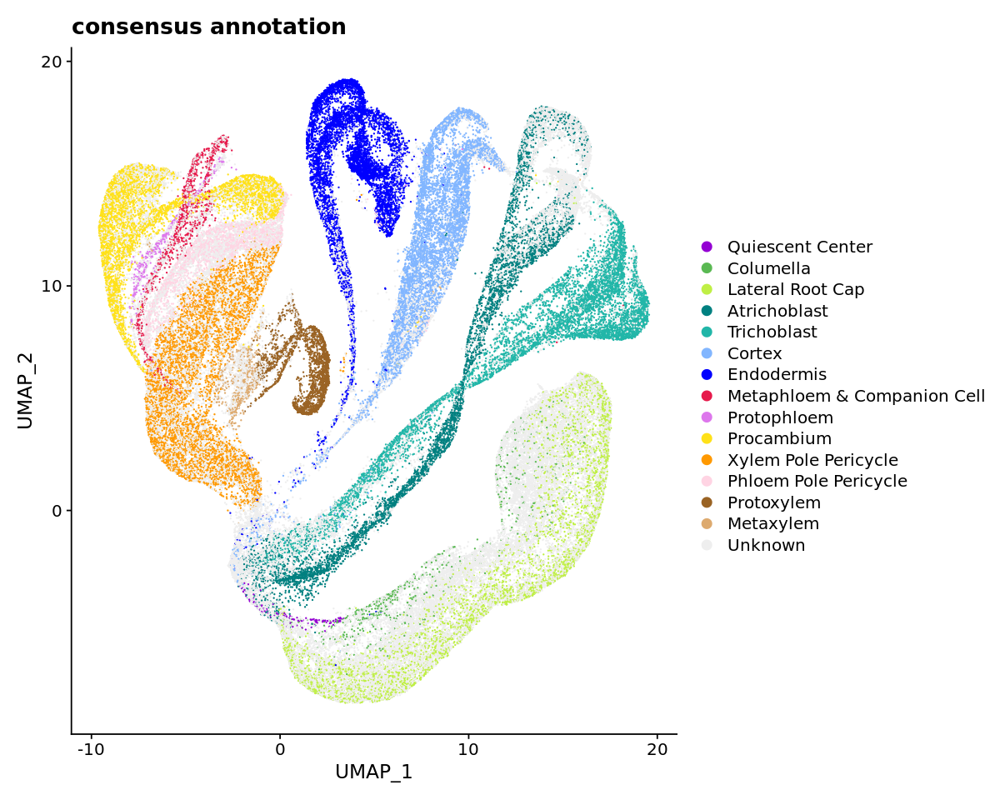

In [163]:
# Plot initial consensus annotation
order <- c("Quiescent Center", "Ground Tissue","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Metaphloem & Companion Cell","Protophloem", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#dd77ec", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$cb.anno <- factor(rc.integrated$cb.anno, levels = order[sort(match(unique(rc.integrated$cb.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$cb.anno),order))]
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "cb.anno", cols = color)+ggtitle("consensus annotation")

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 110427
Number of edges: 3393008

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.9584
Number of communities: 29
Elapsed time: 78 seconds


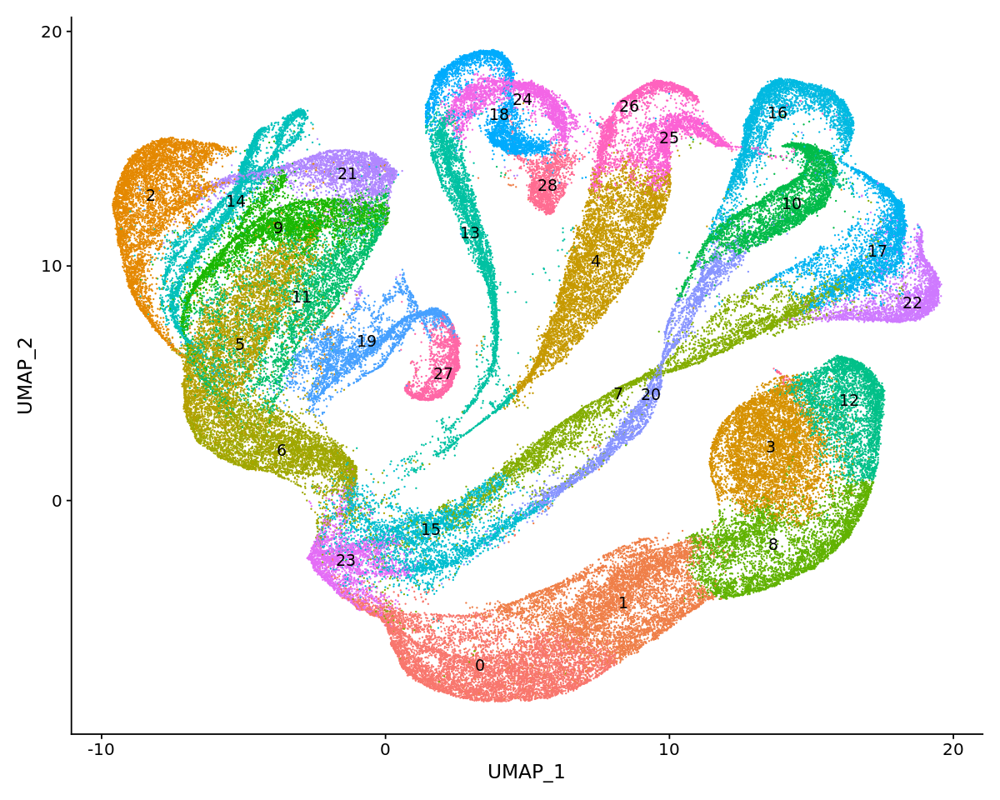

In [164]:
# Find clusters, here we choose SLM clustering algorithm with resolution 0.5. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
suppressMessages(suppressWarnings(
  rc.integrated <- FindClusters(rc.integrated, resolution = 0.5, algorithm = 3)
))
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", label=TRUE)+NoLegend()

In [165]:
# Only denoise clusters that contain one dominant labels
for (i in c("2","4","7","10","16","17","18","20","21","22","24","25","26","27","28")){
    rc.integrated$cb.anno[which(rc.integrated$seurat_clusters==i)] <- names(which.max(table(rc.integrated$cb.anno[which(rc.integrated$seurat_clusters==i)][-which(rc.integrated$cb.anno[which(rc.integrated$seurat_clusters==i)]=="Unknown")])))
}

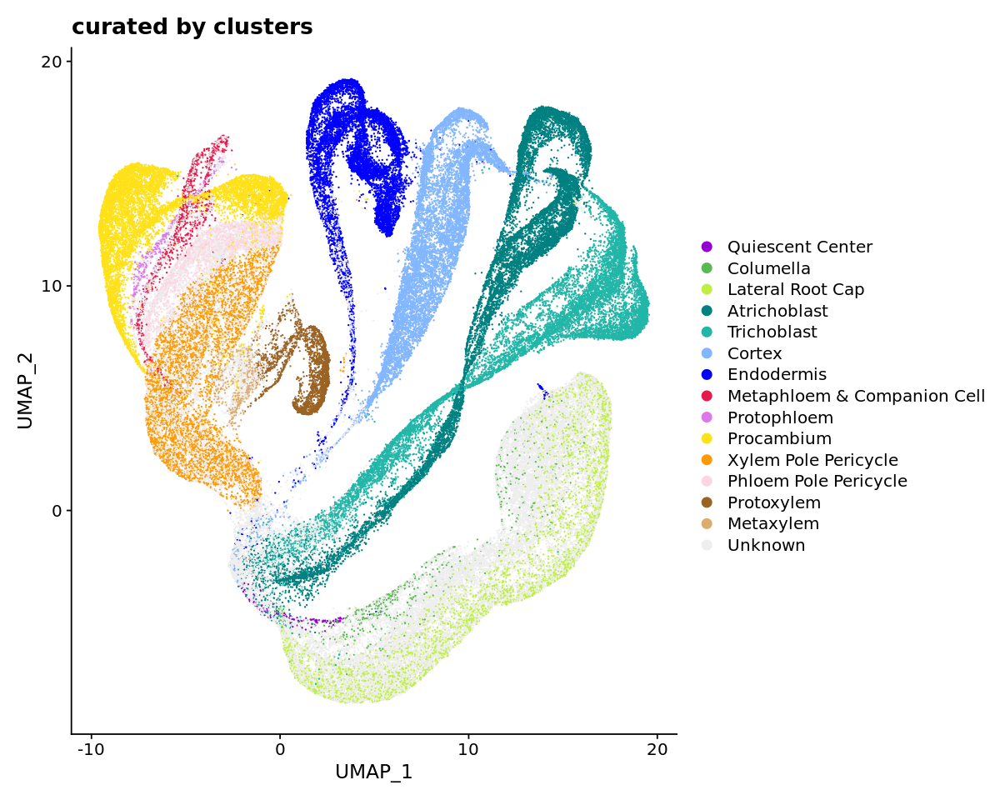

In [166]:
# Plot final consensus annotation
order <- c("Quiescent Center", "Ground Tissue","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Metaphloem & Companion Cell","Protophloem", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#dd77ec", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$cb.anno <- factor(rc.integrated$cb.anno, levels = order[sort(match(unique(rc.integrated$cb.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$cb.anno),order))]
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "cb.anno", cols = color)+ggtitle("curated by clusters")

In [167]:
rc.integrated$cb.anno <- as.character(rc.integrated$cb.anno)
rc.integrated$cb.anno[as.numeric(cb.anno.rootcap.sub.2$order)] <- as.character(cb.anno.rootcap.sub.2$annotation)
cb.anno$annotation <- rc.integrated$cb.anno
cb.anno$annotation[which(cb.anno$annotation == "Columella")] = "Unknown"
cb.anno$annotation[which(cb.anno$annotation == "Columella_1")] = "Unknown"
cb.anno$annotation[which(cb.anno$annotation == "EPI_LRC_1")] = "Unknown"
cb.anno$annotation[which(cb.anno$annotation == "Quiescent Center")] = "Unknown"

In [168]:
table(cb.anno$annotation)


               Atrichoblast                 Columella_2 
                      12173                         114 
                Columella_3                 Columella_4 
                        113                          25 
                Columella_5                 Columella_6 
                         66                         364 
                     Cortex                  Endodermis 
                      10171                        9217 
                      LRC_2                       LRC_3 
                        524                         545 
                      LRC_4                       LRC_5 
                       2527                        1106 
Metaphloem & Companion Cell                   Metaxylem 
                       1463                         579 
      Phloem Pole Pericycle                  Procambium 
                       2182                        8997 
                Protophloem                  Protoxylem 
                        430   

In [169]:
# Merge cell type consensus annotation with time zone correlation-based annotation
long.merge <- as.character(rc.integrated$Long.ID.P)
cb.anno.t <- data.frame(rna=as.character(rc.integrated$timezone.ID.P), ma=long.merge)
cb.anno.t$order <- seq(1,ncol(rc.integrated))
cb.anno.t$annotation <- apply(cb.anno.t,1,function(x){if(TRUE){x[2]}else{"Unknown"}})
cb.anno.t.sub <- cb.anno.t %>% filter(annotation!="Unknown")
cb.anno.m <- left_join(cb.anno,cb.anno.t.sub,by="order")
cb.anno.m <- cb.anno.m %>% filter(annotation.x != "NA" & annotation.x != "Unknown" & annotation.y != "NA")

# Disect each cell type based on microarray time zone correlation-based annotation to have more grouping of cells/ to give finest resolution 
cb.anno.m$final.annotation <- paste(cb.anno.m$annotation.y, cb.anno.m$annotation.x, sep="-")

In [170]:
# Filter grouping that has too few cells
cb.anno.m$final.annotation[grep(paste(names(table(cb.anno.m$final.annotation)[which(table(cb.anno.m$final.annotation) <= 2)]),collapse = "|"),cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m <- cb.anno.m %>% filter(final.annotation != "Unknown")
length(sort(table(cb.anno.m$final.annotation)))

[1] 153

In [171]:
cb.anno.m$final.annotation[grep("Columella_2$",cb.anno.m$final.annotation)] = "Columella_2"
cb.anno.m$final.annotation[grep("Columella_3$",cb.anno.m$final.annotation)] = "Columella_3"
cb.anno.m$final.annotation[grep("Columella_4$",cb.anno.m$final.annotation)] = "Columella_4"
cb.anno.m$final.annotation[grep("Columella_5$",cb.anno.m$final.annotation)] = "Columella_5"
cb.anno.m$final.annotation[grep("Columella_6$",cb.anno.m$final.annotation)] = "Columella_6"
cb.anno.m$final.annotation[grep("^Elong-[0-9]-LRC_[2-3]$",cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m$final.annotation[grep("^Mat-[0-9][0-9]-LRC_[2-3]$",cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m$final.annotation[grep("^Meri-[0-9]-LRC_[4-5]$",cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m$final.annotation[grep("^Columella-LRC_[4-5]$",cb.anno.m$final.annotation)] = "Unknown"
cb.anno.m$final.annotation[grep("LRC_4$",cb.anno.m$final.annotation)] = "LRC_4"
cb.anno.m$final.annotation[grep("LRC_5$",cb.anno.m$final.annotation)] = "LRC_5"
cb.anno.m <- cb.anno.m %>% filter(final.annotation != "Unknown")

In [172]:
rc.integrated$cb.anno <- rep("Unknown", ncol(rc.integrated))
rc.integrated$cb.anno[as.numeric(cb.anno.m$order)] <- as.character(cb.anno.m$final.annotation)

In [173]:
# 106 new reference expression profiles are going to be build
length(sort(table(rc.integrated$cb.anno[which(rc.integrated$cb.anno!="Unknown")])))

[1] 106

In [174]:
sort(table(rc.integrated$cb.anno[which(rc.integrated$cb.anno!="Unknown")]))


                      Mat-12-Cortex                   Meri-1-Protoxylem 
                                  3                                   3 
                       Meri-4-LRC_3                  Meri-5-Protophloem 
                                  3                                   3 
                  Meri-6-Endodermis                    Meri-6-Metaxylem 
                                  3                                   3 
 Meri-3-Metaphloem & Companion Cell                        Meri-6-LRC_2 
                                  4                                   4 
                 Mat-11-Protophloem                   Meri-4-Endodermis 
                                  5                                   5 
 Meri-4-Metaphloem & Companion Cell                Elong-8-Atrichoblast 
                                  5                                   6 
                 Mat-10-Protophloem                  Mat-9-Atrichoblast 
                                  6               

## 9. Build new reference expression profiles based on consensus annotation 

In [175]:
# Extract integrated (batch-corrected) expression matrix
afm <- rc.integrated@assays$integrated@data

# Pool (average) expression values of each grouping
new_ref <- matrix(nrow=nrow(afm), ncol = 0)
for (i in 1:106) {
m <- afm[,which(rc.integrated$cb.anno==as.character(unique(rc.integrated$cb.anno[which(rc.integrated$cb.anno!="Unknown")]))[i])]
new_ref <- cbind(new_ref, rowSums(m)/ncol(m))
}
colnames(new_ref) <- as.character(unique(rc.integrated$cb.anno[which(rc.integrated$cb.anno!="Unknown")]))
gene.var <- apply(new_ref,1,var)

# Select top 200 highly variable genes 
new_ref_sub <- new_ref[names(sort(gene.var,decreasing = TRUE)[1:200]),]

# Merge newly-built reference with atlas

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}

nr <- Reduce(merge.rownames, list(new_ref_sub,afm)) 
nr <- as.matrix(nr)

In [176]:
colnames(nr)[1:107]

[1] "Meri-5-Atrichoblast"                
  [2] "Elong-7-Atrichoblast"               
  [3] "Elong-7-Cortex"                     
  [4] "Columella_6"                        
  [5] "Elong-8-Phloem Pole Pericycle"      
  [6] "Elong-8-Protoxylem"                 
  [7] "Elong-8-Xylem Pole Pericycle"       
  [8] "Elong-8-Endodermis"                 
  [9] "Elong-8-Metaphloem & Companion Cell"
 [10] "Elong-8-Procambium"                 
 [11] "Mat-10-Cortex"                      
 [12] "Mat-11-Trichoblast"                 
 [13] "Mat-10-Atrichoblast"                
 [14] "Meri-5-Endodermis"                  
 [15] "Meri-6-Trichoblast"                 
 [16] "Mat-10-Procambium"                  
 [17] "Meri-5-Trichoblast"                 
 [18] "Elong-7-Trichoblast"                
 [19] "Meri-6-Cortex"                      
 [20] "Mat-10-Trichoblast"                 
 [21] "Elong-7-Endodermis"                 
 [22] "Columella_3"                        
 [23] "Elong-7-Xylem Pole Pericycle"       
 [24] "Mat-10-Xylem Pole Pericycle"        
 [25] "Mat-10-Protoxylem"                  
 [26] "Elong-7-Procambium"                 
 [27] "Mat-10-Endodermis"                  
 [28] "Meri-3-Xylem Pole Pericycle"        
 [29] "LRC_4"                              
 [30] "Mat-11-Atrichoblast"                
 [31] "Elong-7-Protoxylem"                 
 [32] "Mat-11-Cortex"                      
 [33] "LRC_5"                              
 [34] "Meri-5-LRC_3"                       
 [35] "Mat-11-Xylem Pole Pericycle"        
 [36] "Meri-6-Atrichoblast"                
 [37] "Elong-8-Metaxylem"                  
 [38] "Columella_2"                        
 [39] "Meri-3-LRC_3"                       
 [40] "Meri-4-Trichoblast"                 
 [41] "Meri-3-Cortex"                      
 [42] "Meri-3-Trichoblast"                 
 [43] "Mat-11-Procambium"                  
 [44] "Meri-3-Atrichoblast"                
 [45] "Mat-9-Trichoblast"                  
 [46] "Elong-7-Phloem Pole Pericycle"      
 [47] "Mat-11-Phloem Pole Pericycle"       
 [48] "Meri-5-Metaxylem"                   
 [49] "Meri-5-Xylem Pole Pericycle"        
 [50] "Elong-8-Protophloem"                
 [51] "Mat-11-Protoxylem"                  
 [52] "Meri-5-LRC_2"                       
 [53] "Mat-10-Metaphloem & Companion Cell" 
 [54] "Mat-11-Metaphloem & Companion Cell" 
 [55] "Meri-5-Cortex"                      
 [56] "Meri-6-Procambium"                  
 [57] "Meri-2-Atrichoblast"                
 [58] "Meri-3-Endodermis"                  
 [59] "Columella_5"                        
 [60] "Meri-3-Procambium"                  
 [61] "Meri-5-Metaphloem & Companion Cell" 
 [62] "Meri-6-Metaphloem & Companion Cell" 
 [63] "Elong-7-Protophloem"                
 [64] "Mat-11-Endodermis"                  
 [65] "Meri-5-Protoxylem"                  
 [66] "Meri-3-LRC_2"                       
 [67] "Elong-8-Trichoblast"                
 [68] "Meri-3-Metaxylem"                   
 [69] "Meri-5-Procambium"                  
 [70] "Meri-3-Metaphloem & Companion Cell" 
 [71] "Mat-9-Cortex"                       
 [72] "Mat-10-Phloem Pole Pericycle"       
 [73] "Elong-7-Metaphloem & Companion Cell"
 [74] "Meri-2-Endodermis"                  
 [75] "Meri-5-Phloem Pole Pericycle"       
 [76] "Elong-8-Cortex"                     
 [77] "Meri-6-Phloem Pole Pericycle"       
 [78] "Meri-1-Protoxylem"                  
 [79] "Columella_4"                        
 [80] "Meri-1-LRC_3"                       
 [81] "Meri-3-Protoxylem"                  
 [82] "Meri-6-Protophloem"                 
 [83] "Meri-2-LRC_3"                       
 [84] "Mat-9-Endodermis"                   
 [85] "Elong-7-Metaxylem"                  
 [86] "Meri-4-Metaphloem & Companion Cell" 
 [87] "Meri-4-Endodermis"                  
 [88] "Meri-4-Metaxylem"                   
 [89] "Meri-5-Protophloem"                 
 [90] "Meri-2-Cortex"                      
 [91] "Meri-4-Atrichoblast"               

In [177]:
# Correlation-based annotation using newly-built references
nr_label=colnames(new_ref)
nr_stat <- suppressWarnings(sapply(107:ncol(nr), function(i) sapply(1:106, function(j) cor.test(nr[,i],nr[,j],method = "pearson")[c(3,4)])))
nr_cor <- nr_stat[seq(2,nrow(nr_stat),2),]
nr_pvalue <- nr_stat[seq(1,nrow(nr_stat)-1,2),]                                                                                                        
nr_max <- sapply(1:(ncol(nr)-106), function(i) max(as.numeric(nr_cor[,i])))
nr_ident <- sapply(1:(ncol(nr)-106), function(i) nr_label[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])
nr_maxp <- sapply(1:(ncol(nr)-106), function(i) as.numeric(nr_pvalue[,i])[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])                     
names(nr_max) <- nr_ident
rc.integrated$final.anno.P <- as.character(nr_ident)
rc.integrated$final.anno.cor.P <- as.numeric(nr_max)
rc.integrated$final.anno.pvalue.P <- as.numeric(nr_maxp)

In [178]:
rc.integrated$celltype.anno <-  gsub("LRC","Lateral Root Cap",gsub("_[0-9]$","",gsub("^Meri-.*-","",gsub("^Elong-.*-","",gsub("^Mat-.*-","",as.character(rc.integrated$final.anno.P))))))

In [179]:
# Annotation on QC
zscore <- function(x){(x-mean(x))/sd(x)}
cc.z.score <- apply(rc.integrated@assays$SCT@data[cc.genes,], 1, zscore)
qc.z.score <- apply(rc.integrated@assays$SCT@data[known.good.markers[which(known.good.markers$Celltype=="Quiescent Center"),]$Locus,], 1, zscore)
cczs <- apply(cc.z.score[which(rc.integrated$escore.crude.anno=="Quiescent Center"),], 1, mean)
qczs <- apply(qc.z.score[which(rc.integrated$escore.crude.anno=="Quiescent Center"),], 1, mean)
cczs.all <- apply(cc.z.score, 1, mean)
qczs.all <- apply(qc.z.score, 1, mean)
QC.idx <- match(names(which(cczs <= mean(cczs.all[which(qczs.all >= 0)])+1.5*IQR(cczs.all[which(qczs.all >= 0)]) & qczs >=0)), colnames(rc.integrated))
rc.integrated$celltype.anno[QC.idx] <- "Quiescent Center"

In [181]:
# Only denoise clusters that contain one dominant labels
for (i in c("2","4","7","10","16","17","18","20","21","22","24","25","26","27","28")){
    rc.integrated$celltype.anno[which(rc.integrated$seurat_clusters==i)] <- names(which.max(table(rc.integrated$celltype.anno[which(rc.integrated$seurat_clusters==i)])))
}

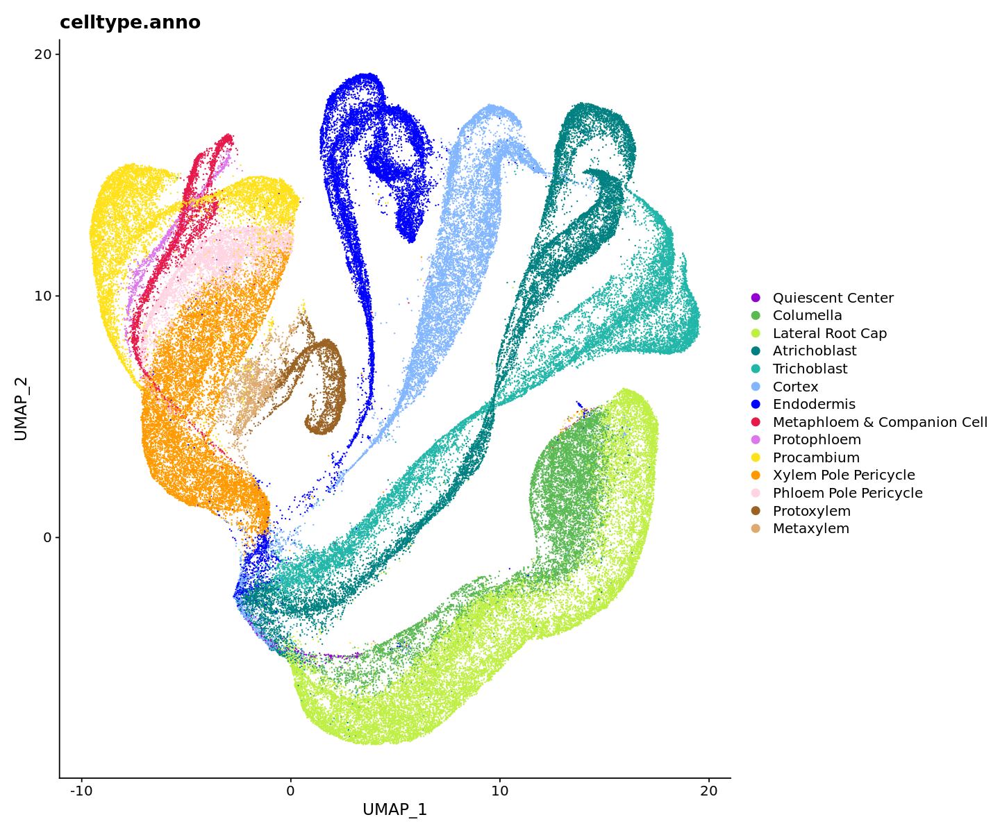

In [182]:
# Plot new correlation-based annotation (final annotation)
order <- c("Quiescent Center", "Ground Tissue","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Metaphloem & Companion Cell","Protophloem", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#dd77ec", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno, levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

In [183]:
table(rc.integrated$celltype.anno)


           Quiescent Center                   Columella 
                        158                        8535 
           Lateral Root Cap                Atrichoblast 
                      18396                       13380 
                Trichoblast                      Cortex 
                      12361                       11073 
                 Endodermis Metaphloem & Companion Cell 
                      11369                        3224 
                Protophloem                  Procambium 
                        939                        9307 
       Xylem Pole Pericycle       Phloem Pole Pericycle 
                      12213                        4634 
                 Protoxylem                   Metaxylem 
                       3195                        1643 

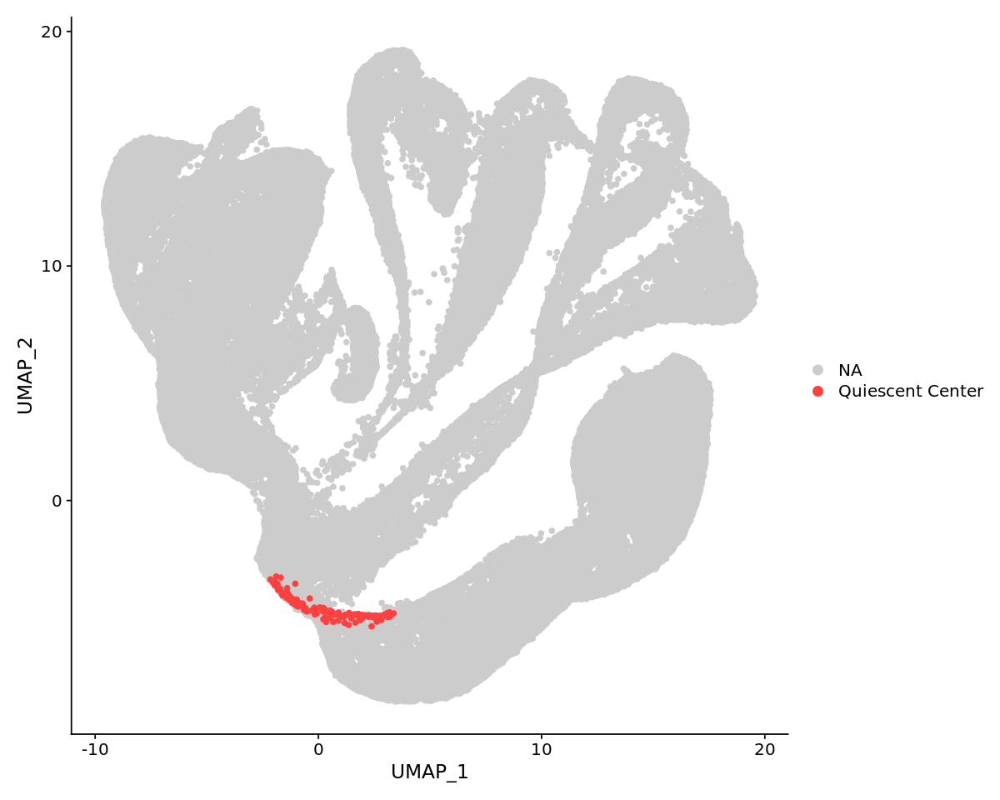

In [184]:
# Plot QC
temp <- rep("NA", ncol(rc.integrated))
temp[QC.idx]="Quiescent Center"
rc.integrated$temp <- temp
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "temp", order = c("Quiescent Center","NA"),cols=c("#cccccc", "#ff4040"), pt.size=1.5)

In [185]:
table(rc.integrated$orig.ident[QC.idx])


    col0      dc1      dc2      pp1     sc_1 sc_10_at    sc_11    sc_12 
      11       19       22        8        3       12       24        6 
   sc_31    sc_40    sc_51  sc_9_at     tnw1     tnw2 
      10        2       12        9        9       11 

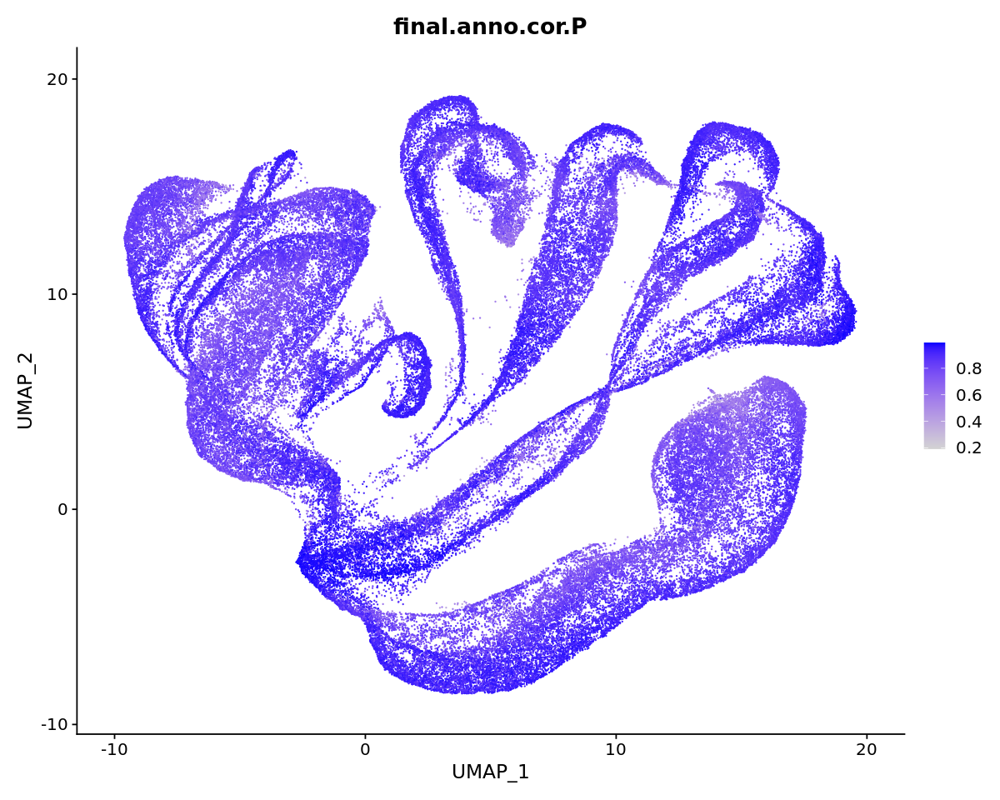

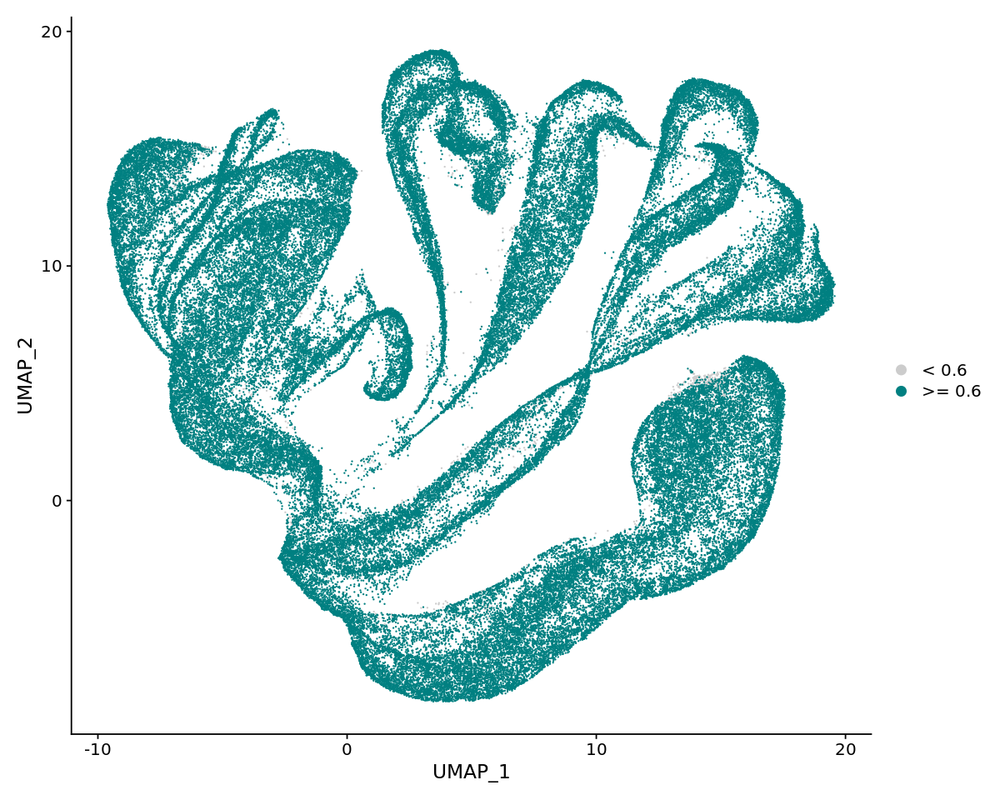

In [186]:
# Plot correlation coefficient
rc.integrated$final.anno.P_significance <- rep(">= 0.6", nrow(rc.integrated@meta.data))
rc.integrated$final.anno.P_significance[which(rc.integrated$final.anno.cor.P < 0.6)] = "< 0.6"
FeaturePlot(rc.integrated, reduction = "umap", features = "final.anno.cor.P")
DimPlot(rc.integrated, reduction = "umap", group.by = "final.anno.P_significance", order = c(">= 0.6","< 0.6"),cols = c("#cccccc", "#008081"))

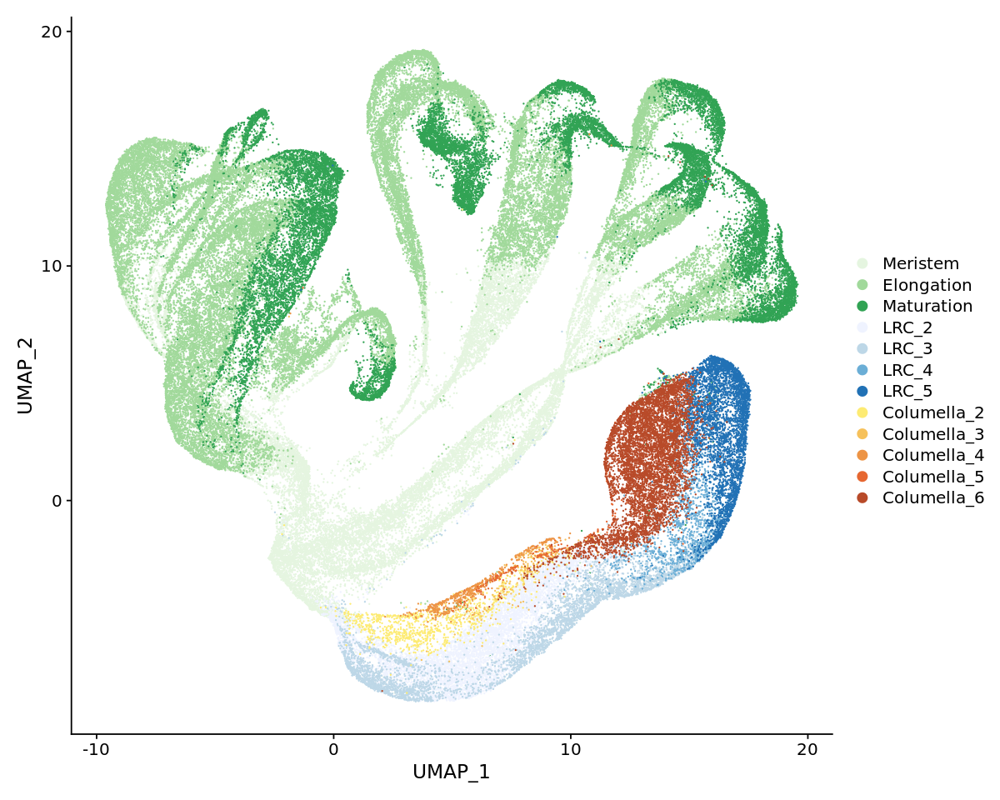

In [187]:
temp <- rep("NA", ncol(rc.integrated))
temp[grep("^Meri",rc.integrated$final.anno.P)]="Meristem"
temp[grep("^Elong",rc.integrated$final.anno.P)]="Elongation"
temp[grep("^Mat",rc.integrated$final.anno.P)]="Maturation"
temp[grep("^Columella",rc.integrated$final.anno.P)]="Maturation"
temp[grep("LRC_2$",rc.integrated$final.anno.P)]="LRC_2"
temp[grep("LRC_3$",rc.integrated$final.anno.P)]="LRC_3"
temp[grep("LRC_4$",rc.integrated$final.anno.P)]="LRC_4"
temp[grep("LRC_5$",rc.integrated$final.anno.P)]="LRC_5"
temp[grep("Columella_6$",rc.integrated$final.anno.P)]="Columella_6"
temp[grep("Columella_5$",rc.integrated$final.anno.P)]="Columella_5"
temp[grep("Columella_3$",rc.integrated$final.anno.P)]="Columella_3"
temp[grep("Columella_2$",rc.integrated$final.anno.P)]="Columella_2"
temp[grep("Columella_4$",rc.integrated$final.anno.P)]="Columella_4"
#temp[QC.idx]="Meristem"
rc.integrated$time.anno.fine <- temp
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno.fine",order = c("Columella_6","Columella_5","Columella_4","Columella_3","Columella_2","LRC_5","LRC_4","LRC_3","LRC_2","Maturation","Elongation","Meristem"),cols = c("#e5f5e0", "#a1d99b", "#31a354", "#eff3ff", "#bdd7e7", "#6baed6", "#2171b5", '#FDEB73','#F6C15B','#ED9445','#E66731','#B84A29'))

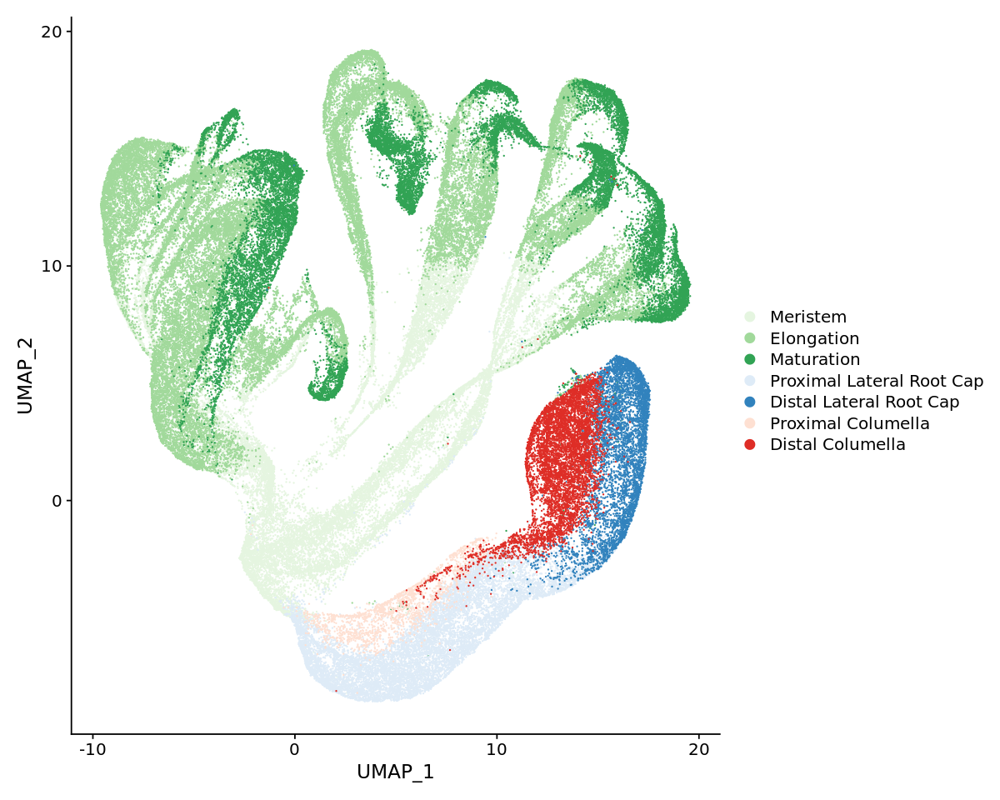

In [188]:
# Merge layers of root caps
temp <- rep("NA", ncol(rc.integrated))
temp[grep("^Meri",rc.integrated$final.anno.P)]="Meristem"
temp[grep("^Elong",rc.integrated$final.anno.P)]="Elongation"
temp[grep("^Mat",rc.integrated$final.anno.P)]="Maturation"
temp[grep("^Columella",rc.integrated$final.anno.P)]="Maturation"
temp[grep("LRC_2$",rc.integrated$final.anno.P)]="Proximal Lateral Root Cap"
temp[grep("LRC_3$",rc.integrated$final.anno.P)]="Proximal Lateral Root Cap"
temp[grep("LRC_4$",rc.integrated$final.anno.P)]="Distal Lateral Root Cap"
temp[grep("LRC_5$",rc.integrated$final.anno.P)]="Distal Lateral Root Cap"
temp[grep("Columella_6$",rc.integrated$final.anno.P)]="Distal Columella"
temp[grep("Columella_5$",rc.integrated$final.anno.P)]="Distal Columella"
temp[grep("Columella_4$",rc.integrated$final.anno.P)]="Proximal Columella"
temp[grep("Columella_3$",rc.integrated$final.anno.P)]="Proximal Columella"
temp[grep("Columella_2$",rc.integrated$final.anno.P)]="Proximal Columella"
rc.integrated$time.anno <- temp
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno",order = c("Distal Columella","Proximal Columella","Distal Lateral Root Cap","Proximal Lateral Root Cap","Maturation","Elongation","Meristem"),cols = c("#e5f5e0", "#a1d99b", "#31a354", "#deebf7", "#3182bd", '#fee0d2','#de2d26'))

## Merge sub-types (crude annotation)

In [189]:
rc.integrated$celltype.anno.crude <- gsub("Protoxylem","Xylem",gsub("Metaxylem","Xylem",gsub("Xylem Pole Pericycle","Pericycle",gsub("Phloem Pole Pericycle","Pericycle",gsub("Metaphloem & Companion Cell","Phloem",gsub("Protophloem", "Phloem",rc.integrated$celltype.anno))))))

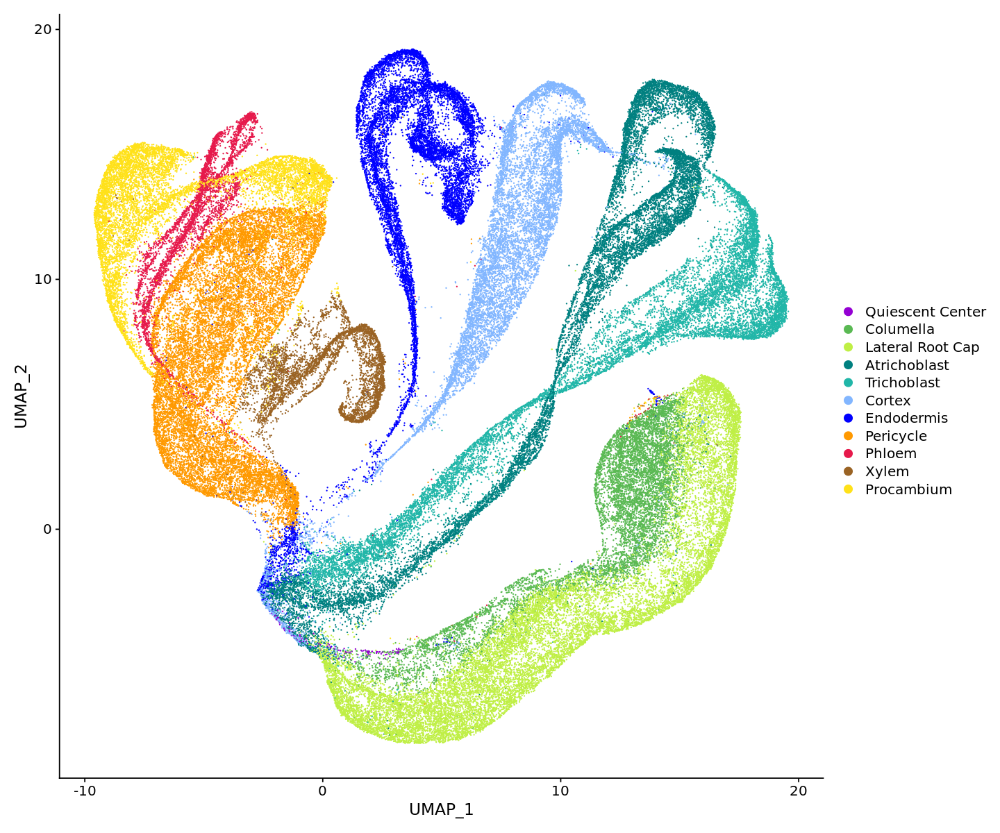

In [190]:
# Plot merged sub-types 
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400d3", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$celltype.anno.crude <- factor(rc.integrated$celltype.anno.crude, levels = order[sort(match(unique(rc.integrated$celltype.anno.crude),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno.crude),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno.crude", cols = color)

In [191]:
rc.integrated$time.celltype.anno.crude <- paste(rc.integrated$time.anno,rc.integrated$celltype.anno.crude,sep="_")

In [192]:
rc.integrated$time.celltype.anno.crude <- gsub("Distal Columella_Columella","Distal Columella",rc.integrated$time.celltype.anno.crude)
rc.integrated$time.celltype.anno.crude <- gsub("Proximal Columella_Columella","Proximal Columella",rc.integrated$time.celltype.anno.crude)
rc.integrated$time.celltype.anno.crude <- gsub("Distal Lateral Root Cap_Lateral Root Cap","Distal Lateral Root Cap",rc.integrated$time.celltype.anno.crude)
rc.integrated$time.celltype.anno.crude <- gsub("Proximal Lateral Root Cap_Lateral Root Cap","Proximal Lateral Root Cap",rc.integrated$time.celltype.anno.crude)

In [199]:
rc.integrated$time.anno[grep("^Proximal Columella_",rc.integrated$time.celltype.anno.crude)] <- "Meristem"
rc.integrated$time.anno[grep("^Proximal Lateral Root Cap_",rc.integrated$time.celltype.anno.crude)] <- "Meristem"
rc.integrated$time.anno[grep("^Distal Columella_",rc.integrated$time.celltype.anno.crude)] <- "Maturation"
rc.integrated$time.anno[grep("^Distal Lateral Root Cap_",rc.integrated$time.celltype.anno.crude)] <- "Maturation"

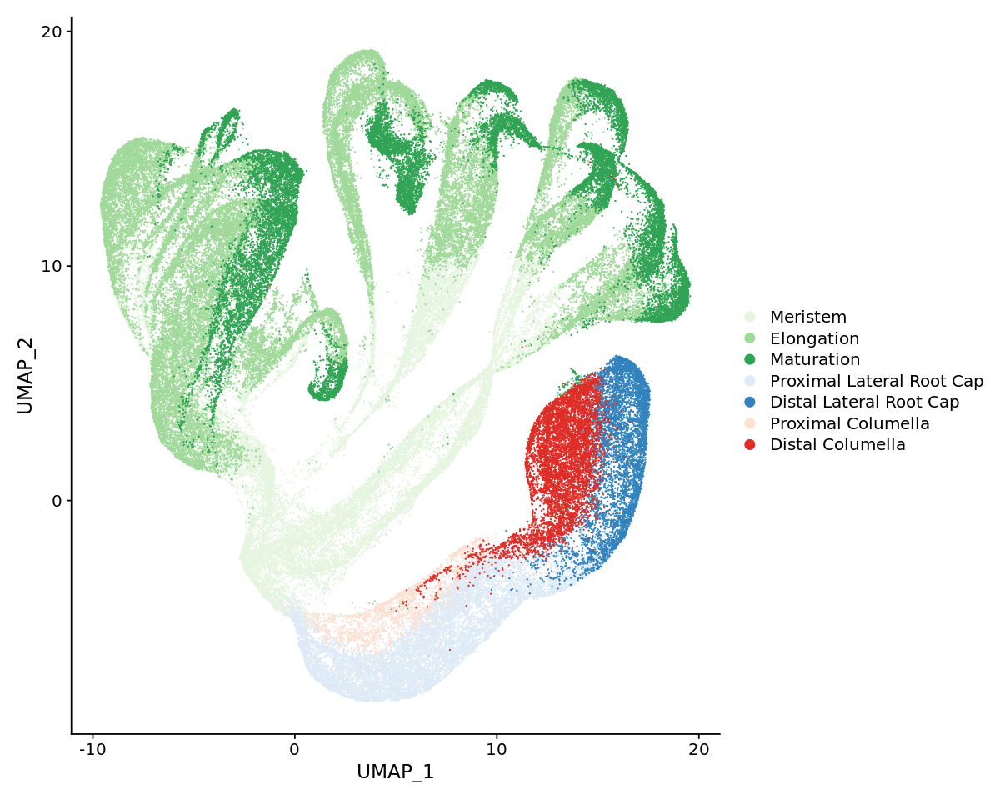

In [200]:
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno",order = c("Distal Columella","Proximal Columella","Distal Lateral Root Cap","Proximal Lateral Root Cap","Maturation","Elongation","Meristem"),cols = c("#e5f5e0", "#a1d99b", "#31a354", "#deebf7", "#3182bd", '#fee0d2','#de2d26'))

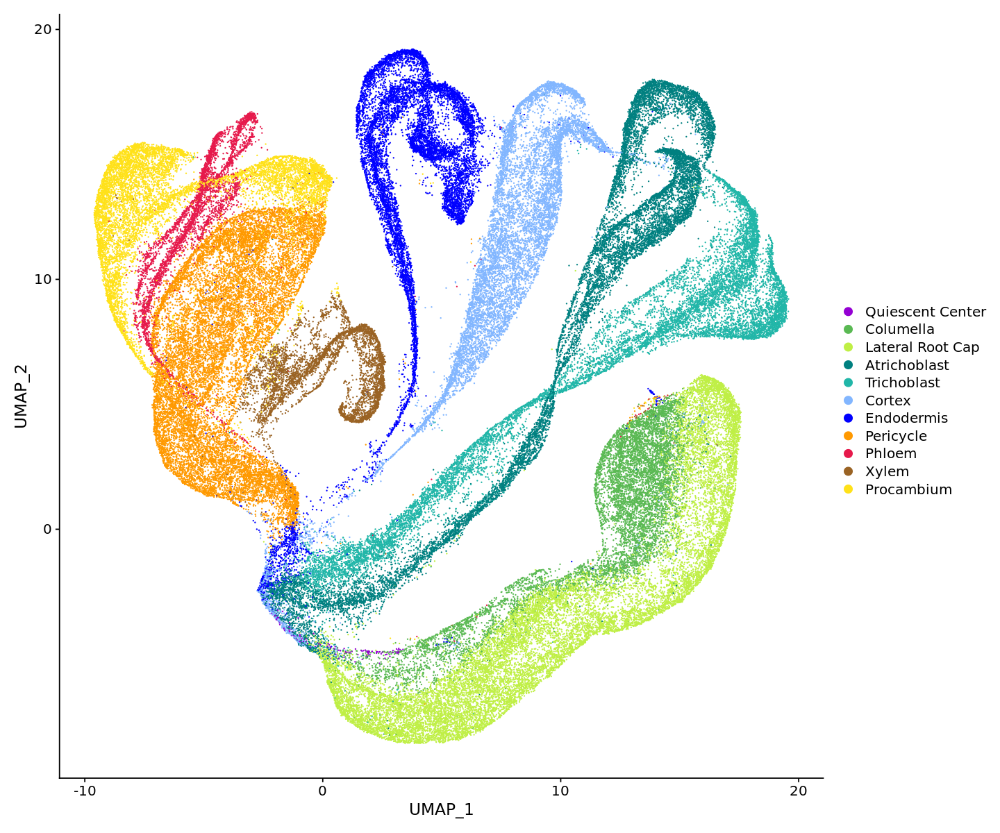

In [201]:
rc.integrated$celltype.anno.crude <- gsub("Protoxylem","Xylem",gsub("Metaxylem","Xylem",gsub("Xylem Pole Pericycle","Pericycle",gsub("Phloem Pole Pericycle","Pericycle",gsub("Metaphloem & Companion Cell","Phloem",gsub("Protophloem", "Phloem",rc.integrated$celltype.anno))))))
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Pericycle", "Phloem", "Xylem", "Procambium", "Unknown")
palette <- c("#9400d3", "#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#ff9900","#e6194b", "#9a6324", "#ffe119","#EEEEEE")
rc.integrated$celltype.anno.crude <- factor(rc.integrated$celltype.anno.crude, levels = order[sort(match(unique(rc.integrated$celltype.anno.crude),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno.crude),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno.crude", cols = color)

In [202]:
rc.integrated$time.celltype.anno.crude <- paste(rc.integrated$time.anno,rc.integrated$celltype.anno.crude,sep="_")
rc.integrated$time.celltype.anno.crude <- gsub("Distal Columella_Columella","Distal Columella",rc.integrated$time.celltype.anno.crude)
rc.integrated$time.celltype.anno.crude <- gsub("Proximal Columella_Columella","Proximal Columella",rc.integrated$time.celltype.anno.crude)
rc.integrated$time.celltype.anno.crude <- gsub("Distal Lateral Root Cap_Lateral Root Cap","Distal Lateral Root Cap",rc.integrated$time.celltype.anno.crude)
rc.integrated$time.celltype.anno.crude <- gsub("Proximal Lateral Root Cap_Lateral Root Cap","Proximal Lateral Root Cap",rc.integrated$time.celltype.anno.crude)

In [203]:
(table(rc.integrated$time.celltype.anno.crude))


         Distal Columella   Distal Lateral Root Cap   Elongation_Atrichoblast 
                     6771                      5818                      4326 
        Elongation_Cortex     Elongation_Endodermis      Elongation_Pericycle 
                     4630                      6500                     10008 
        Elongation_Phloem     Elongation_Procambium    Elongation_Trichoblast 
                     2560                      6470                      2655 
         Elongation_Xylem   Maturation_Atrichoblast         Maturation_Cortex 
                     3076                      3375                      2179 
    Maturation_Endodermis      Maturation_Pericycle         Maturation_Phloem 
                     3116                      3676                       758 
    Maturation_Procambium    Maturation_Trichoblast          Maturation_Xylem 
                     2130                      4334                      1108 
    Meristem_Atrichoblast           Meristem_Cortex

In [204]:
# Save Seurat object
saveRDS(rc.integrated, file='./Root_Atlas.rds')